# Endometriosis - Clustering
# Mesenchymal Cells - all datasets

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import anndata
import os
import sys

def MovePlots(plotpattern, subplotdir):
    os.system('mkdir -p '+str(sc.settings.figdir)+'/'+subplotdir)
    os.system('mv '+str(sc.settings.figdir)+'/*'+plotpattern+'** '+str(sc.settings.figdir)+'/'+subplotdir)

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.figdir = './figures/cells/mesenchymal_dirty/'
sc.settings.set_figure_params(dpi=80)  # low dpi (dots per inch) yields small inline figures

sys.executable

'/home/jovyan/my-conda-envs/sc_analysis/bin/python'

## Load data

In [2]:
path2datas = '/nfs/team292/lg18/endometriosis/integrated_objects/'
adata = sc.read(path2datas+'cells_mesenchymal_integrated.h5ad')
adata.X.shape

(195494, 17736)

## Add sample metadata

In [3]:
meta_sample = pd.read_csv('metadata-libraries_deconvoluted.csv',index_col=1)
meta_sample


annot = meta_sample['Biopsy_type'].to_dict()
adata.obs['Biopsy_type'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Biopsy_type'].value_counts())

annot = meta_sample['Tissue_sampled'].to_dict()
adata.obs['Tissue_sampled'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Tissue_sampled'].value_counts())

annot = meta_sample['Group'].to_dict()
adata.obs['Group'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Group'].value_counts())

annot = meta_sample['Spatial_location'].to_dict()
adata.obs['Spatial_location'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Spatial_location'].value_counts())

annot = meta_sample['Ectopic_group'].to_dict()
adata.obs['Ectopic_group'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Ectopic_group'].value_counts())

annot = meta_sample['BiopsyType_old'].to_dict()
adata.obs['BiopsyType_old'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['BiopsyType_old'].value_counts())

annot = meta_sample['Tissue'].to_dict()
adata.obs['Tissue'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Tissue'].value_counts())

annot = meta_sample['Treatment'].to_dict()
adata.obs['Treatment'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Treatment'].value_counts())

annot = meta_sample['10x kit'].to_dict()
adata.obs['10x kit'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['10x kit'].value_counts())


annot = meta_sample['Processing'].to_dict()
adata.obs['Processing'] = adata.obs.Library_genotype.map(annot)
print(adata.obs['Processing'].value_counts())

Superficial_Eutopic    173449
Whole_Uterus            22045
Name: Biopsy_type, dtype: int64
eutopic_endometrium    195494
Name: Tissue_sampled, dtype: int64
Endo_Superficial     90659
Ctrl_Superficial     82790
Ctrl_whole_uterus    22045
Name: Group, dtype: int64
Series([], Name: Spatial_location, dtype: int64)
Series([], Name: Ectopic_group, dtype: int64)
Superficial            161358
Organ_Donor             22045
Control_Endometrium     12091
Name: BiopsyType_old, dtype: int64
None         134812
EN            24728
EN_enrich     22045
Name: Tissue, dtype: int64
Collagenase         94571
Coll.+Trypsin       43814
ColdDig_LiveSort    13909
Unknown             12091
Trypsin              6381
Name: Treatment, dtype: int64
3' v3.1    74966
3' v3.2    38719
3' v3.0    31081
3'         24728
3' v3      13909
Name: 10x kit, dtype: int64
Fresh     122048
Frozen     73446
Name: Processing, dtype: int64


## Add donor metadata

In [4]:
meta_donors = pd.read_csv('metadata-donors.csv',index_col=None)
meta_donors = meta_donors.set_index('Donor')
meta_donors

annot = meta_donors['Endometrial pathology_A-F-H-P'].to_dict()
adata.obs['Endometrial_pathology'] = adata.obs.genotype.map(annot)
set(adata.obs['Endometrial_pathology'])

annot = meta_donors['Endometriosis_stage'].to_dict()
adata.obs['Endometriosis_stage'] = adata.obs.genotype.map(annot)
set(adata.obs['Endometriosis_stage'])

annot = meta_donors['Ectopic_EcP_EcO_EcPA_EcP-D'].to_dict()
adata.obs['Ectopic_EcP_EcO_EcPA_EcP-D'] = adata.obs.genotype.map(annot)
set(adata.obs['Ectopic_EcP_EcO_EcPA_EcP-D'])

annot = meta_donors['Peritoneal_Ovarian_DIE'].to_dict()
adata.obs['Peritoneal_Ovarian_DIE'] = adata.obs.genotype.map(annot)
set(adata.obs['Peritoneal_Ovarian_DIE'])

annot = meta_donors['Hormonal treatment'].to_dict()
adata.obs['Hormonal treatment'] = adata.obs.genotype.map(annot)
set(adata.obs['Hormonal treatment'])

annot = meta_donors['Age'].to_dict()
adata.obs['Age'] = adata.obs.genotype.map(annot)
set(adata.obs['Age'])

annot = meta_donors['Location'].to_dict()
adata.obs['Location'] = adata.obs.genotype.map(annot)
set(adata.obs['Location'])

annot = meta_donors['Binary Stage'].to_dict()
adata.obs['Binary Stage'] = adata.obs.genotype.map(annot)
print(adata.obs['Binary Stage'].value_counts())

annot = meta_donors['Stage'].to_dict()
adata.obs['Stage'] = adata.obs.genotype.map(annot)
adata.obs['Stage'].value_counts()

Secretory                 94884
Proliferative             77850
Hormones                  18825
Menstrual                  3769
PeriMenopause_Hormones      166
Name: Binary Stage, dtype: int64


Proliferative                     49312
Secretory Early                   33238
Secretory Mid                     23830
Proliferative Early               18325
Secretory Early-Mid               17579
Secretory                         11441
Hormones                          10826
Secretory Late                     8796
Proliferative Late                 4884
Menstrual                          3769
Hormones (Proliferative Early)     3375
Hormones (Inactive)                3347
Unknown                            3220
Proliferative Disordered           2109
Hormones Menstrual                 1123
Menopause_Hormones                  166
Hormones (Secretory Early)          154
Name: Stage, dtype: int64

In [5]:
adata.write('/nfs/team292/lg18/endometriosis/integrated_objects/cells_mesenchymal_integrated.h5ad')

... storing 'Processing' as categorical
... storing 'Tissue' as categorical
... storing 'Treatment' as categorical
... storing '10x kit' as categorical
... storing 'Group' as categorical
... storing 'Endometriosis_stage' as categorical
... storing 'Peritoneal_Ovarian_DIE' as categorical
... storing 'Hormonal treatment' as categorical
... storing 'Location' as categorical
... storing 'Binary Stage' as categorical
... storing 'Stage' as categorical
... storing 'Ectopic_EcP_EcO_EcPA_EcP-D' as categorical
... storing 'Biopsy_type' as categorical
... storing 'Tissue_sampled' as categorical
... storing 'BiopsyType_old' as categorical
... storing 'Endometrial_pathology' as categorical
... storing 'Age' as categorical


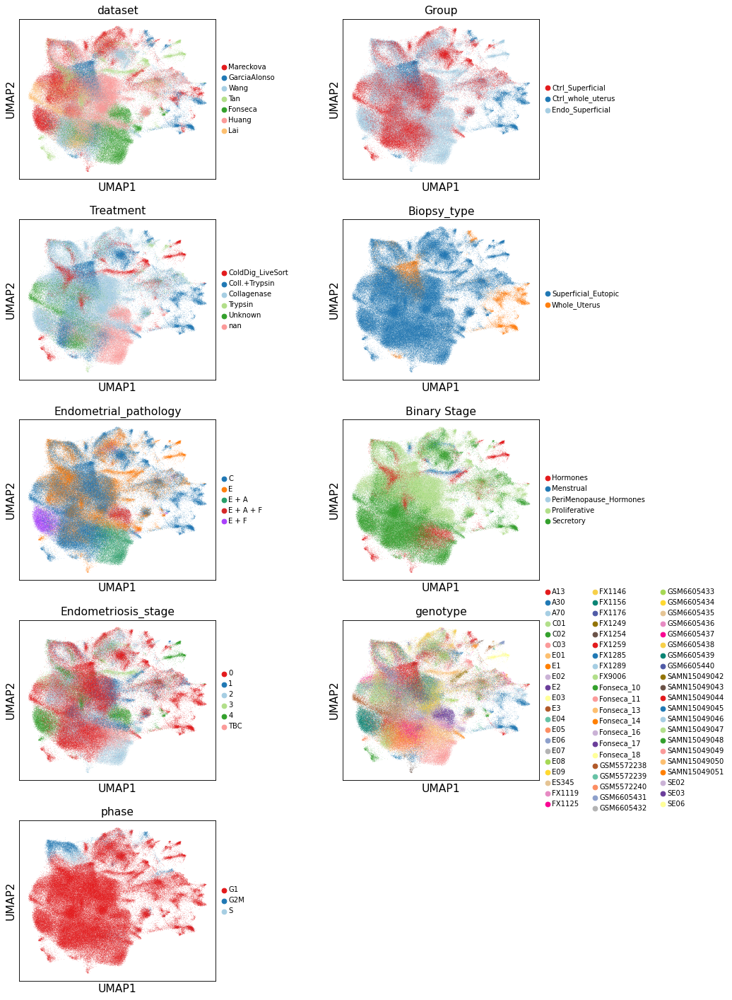

In [6]:
sc.pl.umap(adata, color=['dataset', 'Group', 'Treatment', 'Biopsy_type', 'Endometrial_pathology', 'Binary Stage', 'Endometriosis_stage', 'genotype', 'phase'], wspace=0.5, legend_fontsize=9, ncols=2, save='_allcells_metadata.pdf')

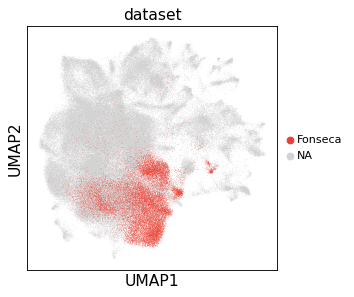

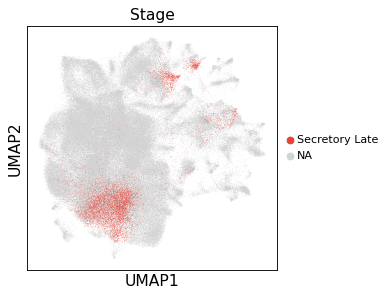

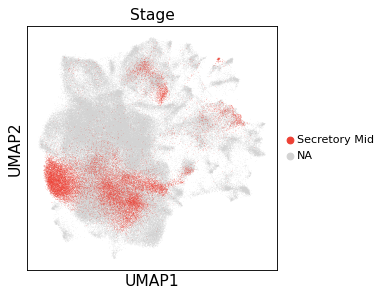

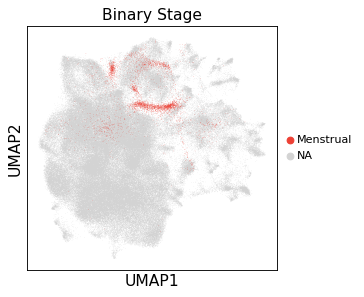

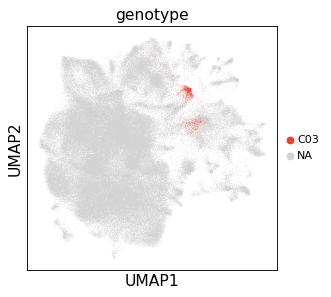

In [7]:
sc.pl.umap(adata,
        groups=['Fonseca'],
        color=['dataset'],
        palette=['#eb4034', '#ed4034'],
        frameon=True, legend_fontsize=10,
    )
del adata.uns['dataset_colors'] 
sc.pl.umap(adata,
        groups=['Secretory Late'],
        color=['Stage'],
        palette=['#eb4034', '#ed4034'],
        frameon=True, legend_fontsize=10,
    )
sc.pl.umap(adata,
        groups=['Secretory Mid'],
        color=['Stage'],
        palette=['#eb4034', '#ed4034'],
        frameon=True, legend_fontsize=10,
    )
sc.pl.umap(adata,
        groups=['Menstrual'],
        color=['Binary Stage'],
        palette=['#eb4034', '#ed4034'],
        frameon=True, legend_fontsize=10,
    )

sc.pl.umap(adata,
        groups=['C03'],
        color=['genotype'],
        palette=['#eb4034', '#ed4034'],
        frameon=True, legend_fontsize=10,
    )
del adata.uns['genotype_colors'] 
del adata.uns['Binary Stage_colors'] 
del adata.uns['Stage_colors'] 

In [8]:
annot_df = pd.read_csv('/nfs/team292/lg18/endometriosis/annotations/cells_endometrium.csv',index_col=0)
annot_df.head()

del adata.obs['Mareckova_celltype'] 
annot = annot_df['Mareckova_celltype'].to_dict()
adata.obs['Mareckova_celltype'] = adata.obs_names.map(annot)
print(adata.obs['Mareckova_celltype'].value_counts())

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3166: DtypeWarning: Columns (5,8,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,39,40,41,42,46,47,55,56,58,59,60,62,69) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


Mesen_dS       96529
Mesen_eS       79488
Mesen_ePV      11325
Mesen_mPV       4618
Mesen_uSMCs     2995
Mesen_FibC7      539
Name: Mareckova_celltype, dtype: int64


In [9]:
annot_df = pd.read_csv('/nfs/team292/lg18/endometriosis/annotations/cells_endometrium_mesenchymal_CLEAN.csv',index_col=0)
annot_df.head()

# del adata.obs['Mareckova_celltype'] 
annot = annot_df['Mareckova_mesen_celltype'].to_dict()
adata.obs['Mareckova_mesen_celltype'] = adata.obs_names.map(annot)
print(adata.obs['Mareckova_mesen_celltype'].value_counts())

eStroma              55612
dStroma              43790
dStroma_early        16804
dStroma_late         12209
eStroma_cycling       7741
PVe_MMP11             7012
Hormones              4132
eStroma_MMPs          3993
PVe_AOC3              2644
uSMCs                 1386
PVe_STEAP4            1382
PVm_MYH11             1354
HOXA13                 844
Other                  558
Fibroblast_C7          420
dStroma_menstrual      172
LowQC                  143
PVe_AOC3_cycling       110
Name: Mareckova_mesen_celltype, dtype: int64


... storing 'Mareckova_mesen_celltype' as categorical
... storing 'Mareckova_celltype' as categorical


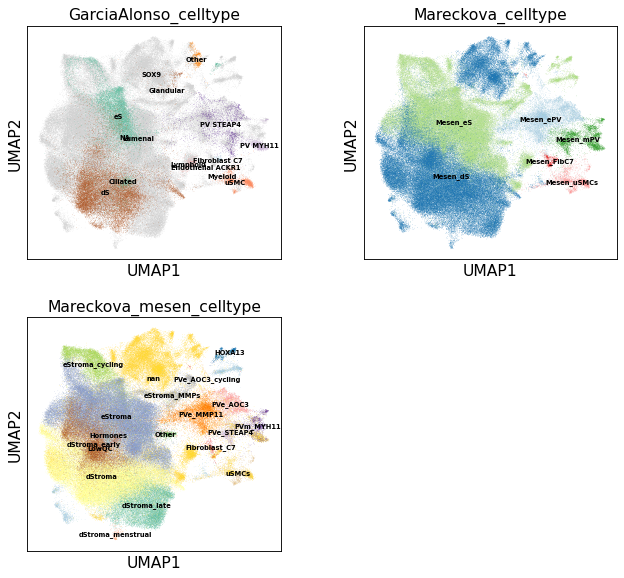

In [10]:
adata.obs['GarciaAlonso_celltype'] = adata.obs['GarciaAlonso_celltype'].replace('nan', np.NaN)
sc.pl.umap(adata, color=['GarciaAlonso_celltype', 'Mareckova_celltype', 'Mareckova_mesen_celltype'], legend_loc='on data', ncols = 2, legend_fontsize=6)

## Clustering the graph
As Seurat and many others, we use the leiden graph-clustering method (community detection based on optimizing modularity). It has been proposed for single-cell data by Levine et al. (2015).

In [11]:
sc.tl.leiden(adata, resolution=1)

running Leiden clustering
    finished: found 20 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:02:47)


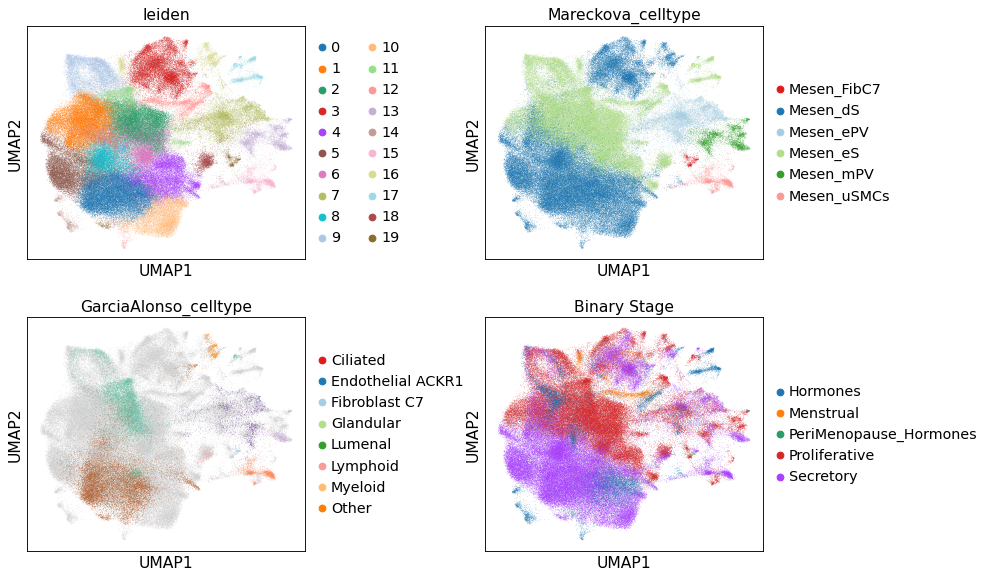

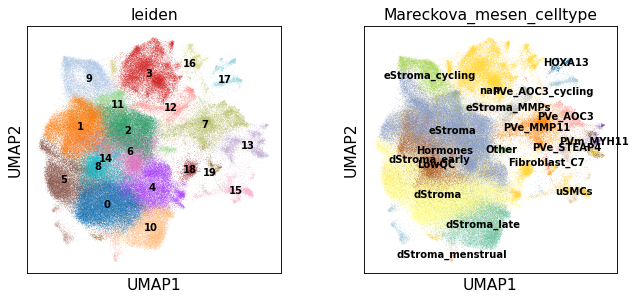

In [12]:
sc.pl.umap(adata, color=['leiden',  'Mareckova_celltype', 'GarciaAlonso_celltype', 'Binary Stage'], wspace=0.5, ncols=2)
sc.pl.umap(adata, color=['leiden', 'Mareckova_mesen_celltype'],legend_loc='on data', legend_fontsize=9)

running Leiden clustering
    finished: found 21 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:01)


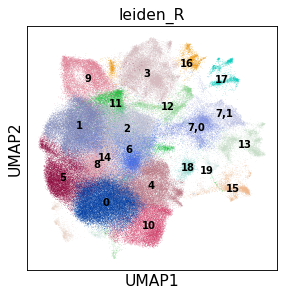

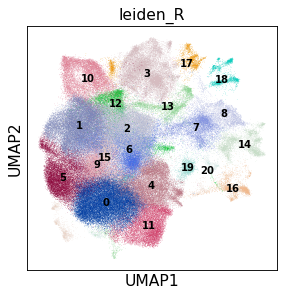

In [13]:
# recluster
sc.tl.leiden(adata, resolution=0.15, restrict_to=('leiden', ['7']))
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden'] = adata.obs['leiden_R']

running Leiden clustering
    finished: found 23 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


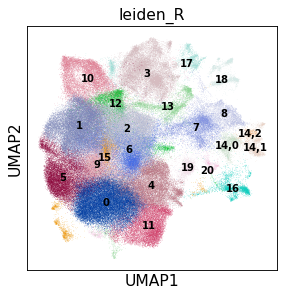

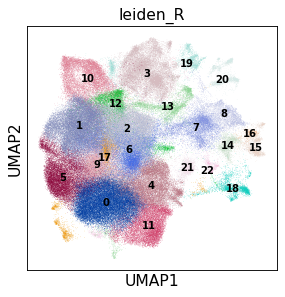

In [14]:
# recluster
sc.tl.leiden(adata, resolution=0.1, restrict_to=('leiden', ['14']))
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden'] = adata.obs['leiden_R']

running Leiden clustering
    finished: found 26 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


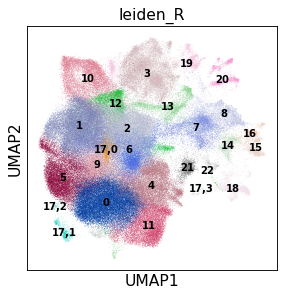

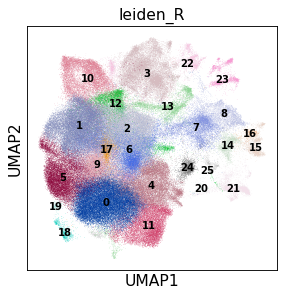

In [15]:
# recluster
sc.tl.leiden(adata, resolution=0.15, restrict_to=('leiden', ['17']))
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden'] = adata.obs['leiden_R']

running Leiden clustering
    finished: found 27 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


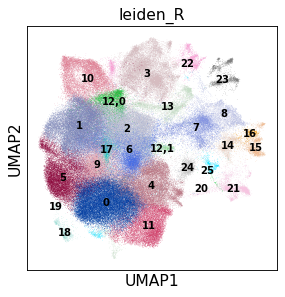

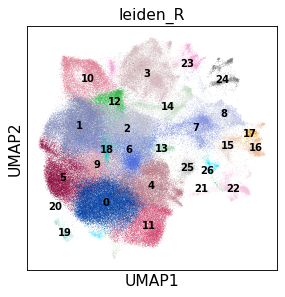

In [16]:
# recluster
sc.tl.leiden(adata, resolution=0.1, restrict_to=('leiden', ['12']))
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden'] = adata.obs['leiden_R']

running Leiden clustering
    finished: found 28 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


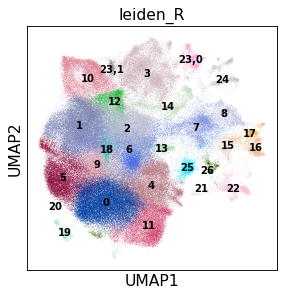

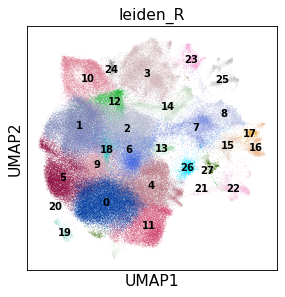

In [17]:
# recluster
sc.tl.leiden(adata, resolution=0.1, restrict_to=('leiden', ['23']))
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden'] = adata.obs['leiden_R']

running Leiden clustering
    finished: found 30 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


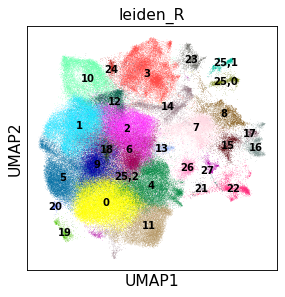

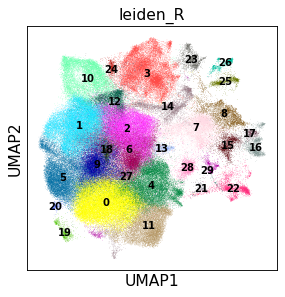

In [18]:
# recluster
sc.tl.leiden(adata, resolution=0.1, restrict_to=('leiden', ['25']))
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden'] = adata.obs['leiden_R']

running Leiden clustering
    finished: found 31 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:01)


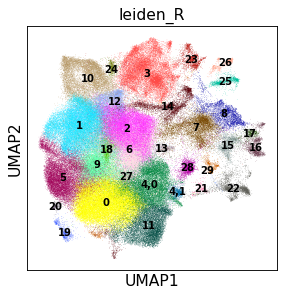

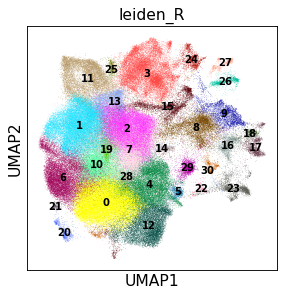

In [19]:
# recluster
sc.tl.leiden(adata, resolution=0.15, restrict_to=('leiden', ['4']))
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden'] = adata.obs['leiden_R']

running Leiden clustering
    finished: found 32 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


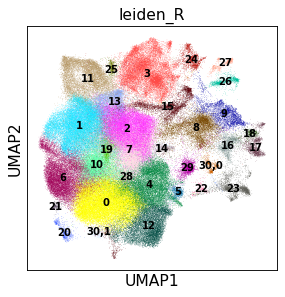

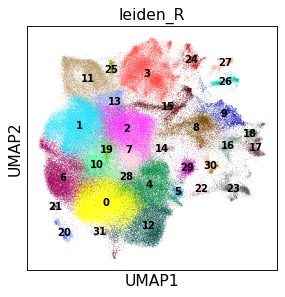

In [20]:
# recluster
sc.tl.leiden(adata, resolution=0.05, restrict_to=('leiden', ['30']))
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden'] = adata.obs['leiden_R']

running Leiden clustering
    finished: found 33 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:01)


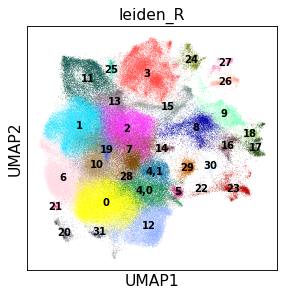

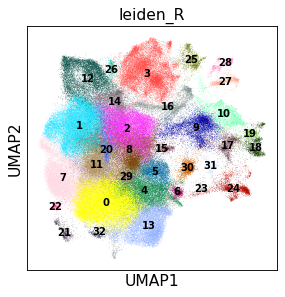

In [21]:
# recluster
sc.tl.leiden(adata, resolution=0.15, restrict_to=('leiden', ['4']))
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
sc.pl.umap(adata, color='leiden_R',legend_loc='on data', legend_fontsize=9)
adata.obs['leiden'] = adata.obs['leiden_R']

# Explore leiden clusters
### Visualize general markers

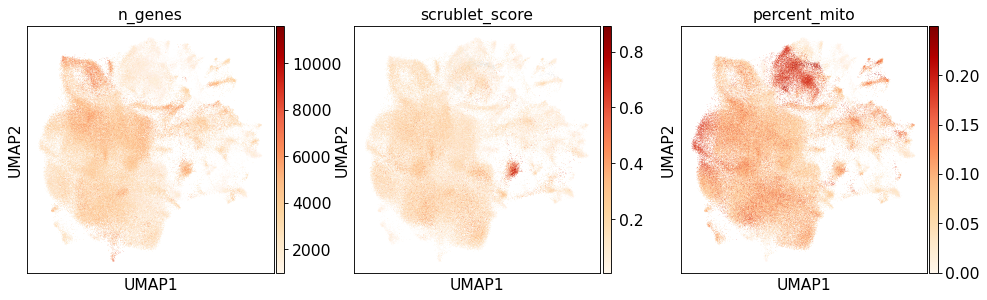

In [22]:
sc.pl.umap(adata, color=['n_genes','scrublet_score', 'percent_mito'], color_map='OrRd')

In [23]:
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

normalizing by total count per cell
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
    finished (0:00:07): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [24]:
marker_genes = {
    'Mesenchymal lineage': {"PDGFRA", 'OGN','DCN', 'LUM'},
    'Mesenchymal stem cells':{'SUSD2'},
    'eS':{'MMP11', 'CRABP2', 'ECM1', 'KLK1', 'TUNAR'},
    'eS MMPs':{'CEMIP', 'INHBA', 'MMP10','MMP3', 'MMP1', 'COL8A1'},
    'eS-dS/P4-induced':{'CILP', 'CALB2', 'PCSK6', 'RND2'},
    'dS':{'C3', 'DKK1', 'IL15', 'CFD',  'TMEM37', 'LMCD1', 'PLA2G2A'}, 
    'dS early':{'SCGB2A1', 'SCGB1D2', 'CXCL13', 'GABRA2', 'TLR4'},
    'dS adenomyosis':{'SMAD7',  'CXCL8', 'IGFBP1'},   
    'dS other':{'HBEGF', 'FOSL1', 'EGR3', 'BACH2',  'FGFR1',  'NFATC2'},     
    'dS menstrual':{'SIGLEC7', 'PRL', 'HSD11B1'},
#     'dS CRISP3':{'CRISP3', 'SLPI'},
    'PV lineage':{'MYH11', 'ACTA2', "MCAM", 'RGS5'},
    'ePV STEAP4':{'STEAP4', 'ARHGAP15', 'SSTR2', 'SMTNL2'},
    'ePV MMP11':{'MMP11', 'TDO2', 'LPL', 'CYGB'},
    "ePV AOC3":{'AOC3', 'SLC38A11', 'CCND1', 'OR51E1' , 'MYOM2', 'FNDC1', 'NTRK2', 'NET1', 'MAP3K7CL', 'NRARP'},
    'mPV MYH11':{'RERGL', 'KCNAB1', 'NTRK2', 'FHL5'},
    'PV lessions CCL19':{'CCL19'},
    'Fibroblast C7': {'C7', 'SCN7A', 'PTGIS'},
    'vascularSMCs':{'SBSPON', 'IGFBP5'},
    'uSMCs':{'LEFTY2', 'ACTG2', 'ITGA11', 'DES', 'PCP4', 'PTGER2', 'PTGER3'},
    'HOXA13':{'CXCL14', 'PGF', 'BMP7', 'HOXA13'},
    'non-vascularSMCs':{'AREG', 'P2RY14'},
    'Epithelial lineage': {'EPCAM', 'PAX8'},
    'Endothelial': {'PECAM1', 'VWF', 'CDH5'},
    'Immune': {'PTPRC'},
    'Lymphoid': {'CD3D', 'NCAM1' , 'NKG7'},
    'Myeloid': {'CSF1R', 'CD14'},
#     'MUC5B+':{"MUC5B", "STRA6", "LTF", "BPIFB1"},
#     'KRT5/TP63':{'KRT5', 'TP63', 'SNCG'},
    'WIF1':{'WIF1'},
    'P4 withdrawal':{'PTGS2', 'CCL2', 'CXCL8'},
#     'Prostaglandin R':{'PTGER4','PTGFR', 'PTGER3', 'PTGIR', 'PTGDR', 'PTGDR2', 'PTGER1', 'PTGER2'},
#     'Prostaglandin S':{ 'PTGES', 'HPGDS', 'PTGS1', 'TBXAS1', 'PTGS2', 'PTGDS', 'PLA2G4A', 'PTGES3', 'PTGIS', 'PTGES2'},
    'HOXA':{'HOXA9', 'HOXA10', 'HOXA11', 'HOXA13', 'HOXD9', 'HOXD10', 'HOXD10', "HOXC4", "HOXC6", "HOXD11"},
    'dS Inflamatory':{"IL15"},
    'MUC5B': {'MUC5B'},
    'lowQC': {"HBA1", "HBA2"}
}

marker_genes_short = {
    'Epithelial lineage': {'EPCAM', 'PAX8'},    
#     'Mesothelial': {'UPK3B', 'LRRN4'},
    'Mesenchymal lineage': {"PDGFRA", 'OGN'}, # 'DCN', 'LUM'
    'PV lineage':{'MYH11', 'ACTA2', "MCAM"},
    'uSMCs':{'LEFTY2', 'ACTG2', 'ITGA11'},
    'Endothelial': {'PECAM1', 'VWF', 'CDH5'},
    'Immune': {'PTPRC'},
    'Lymphoid': {'CD3D', 'NCAM1' , 'NKG7'},
    'Myeloid': {'CSF1R', 'CD14'},
    'Erythroid': {"HBB", "HBA1"}
}

Mesenchymal lineage


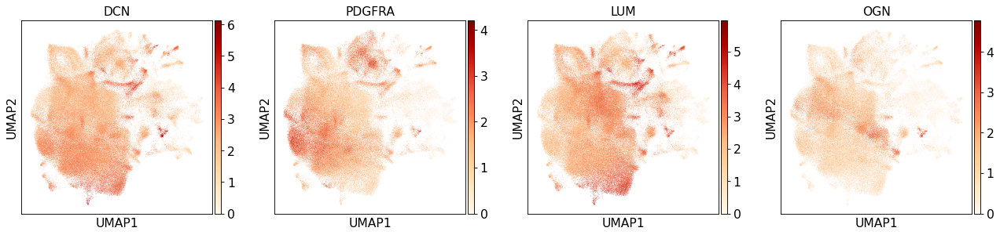

Mesenchymal stem cells


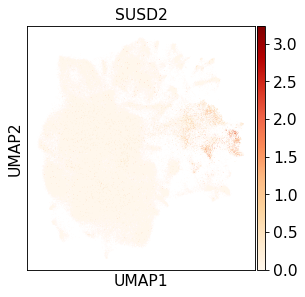

eS


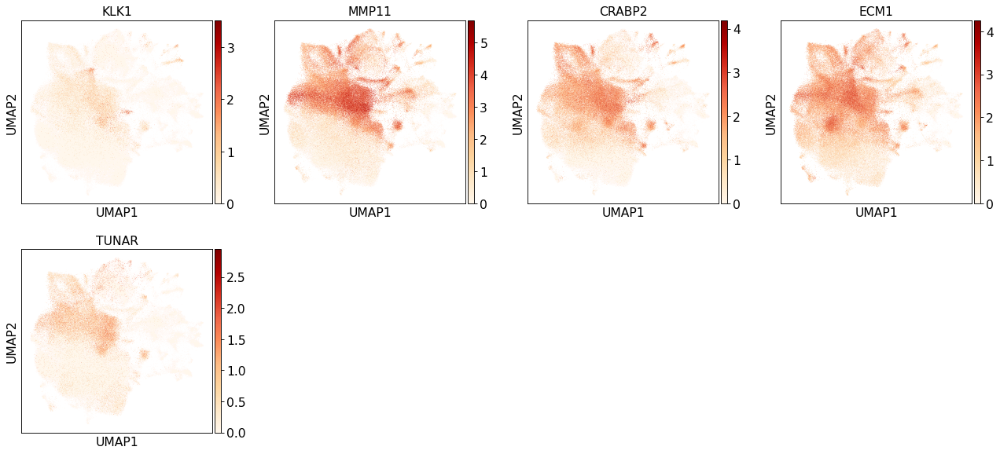

eS MMPs


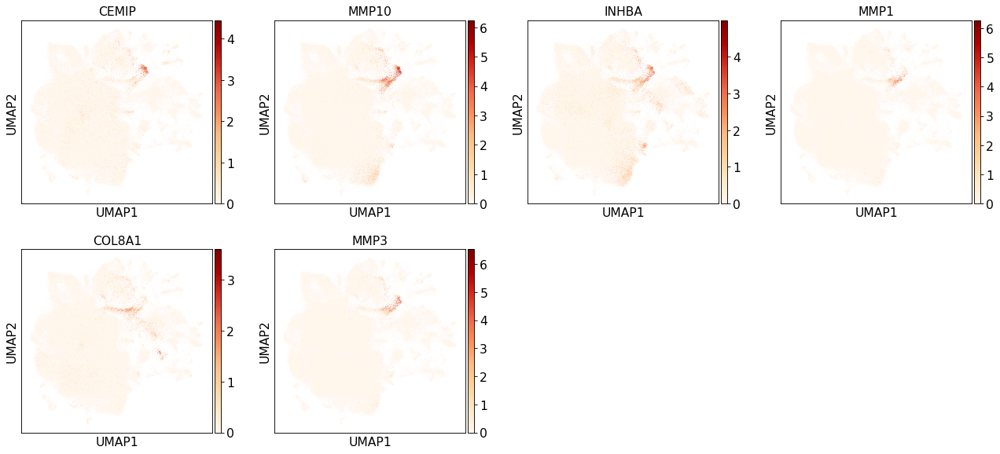

eS-dS/P4-induced


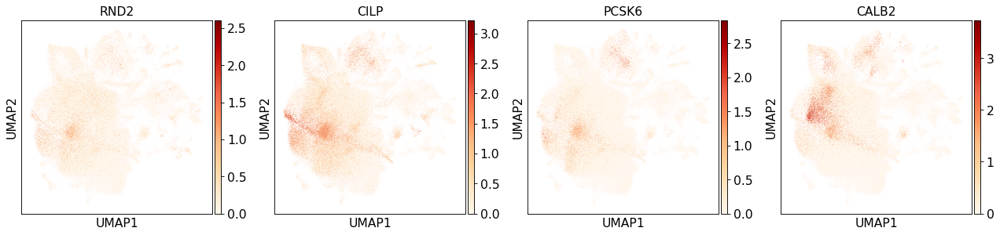

dS


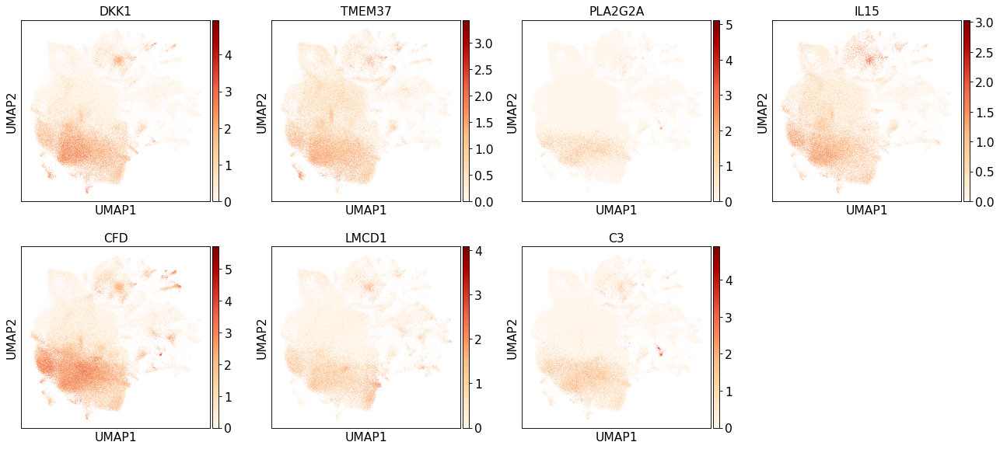

dS early


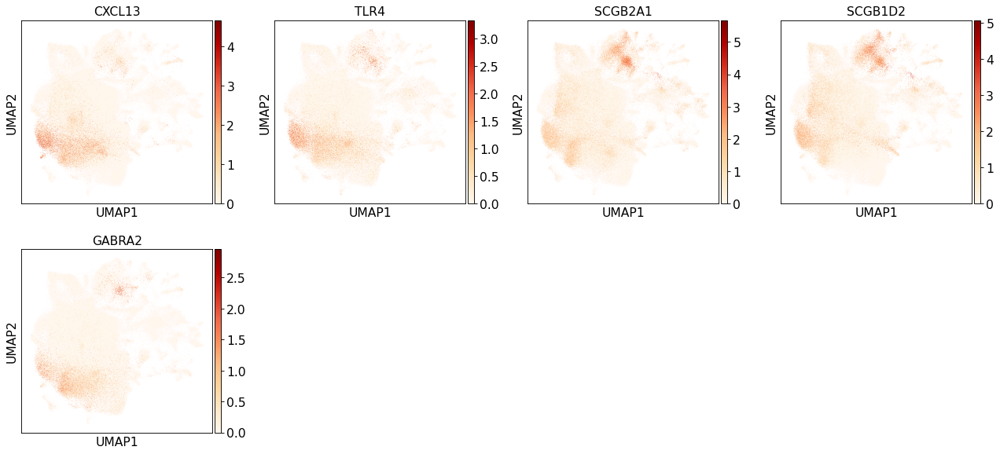

dS adenomyosis


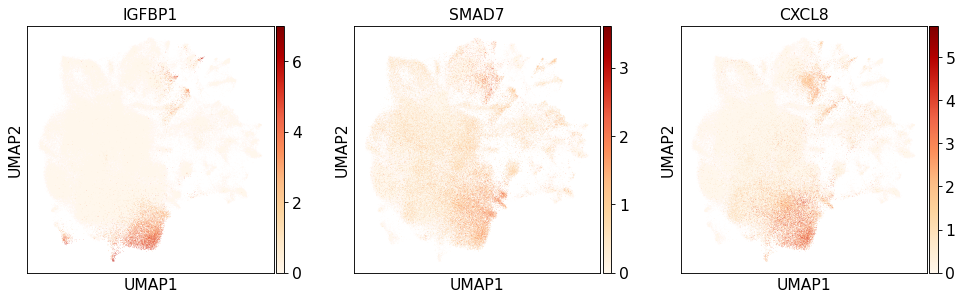

dS other


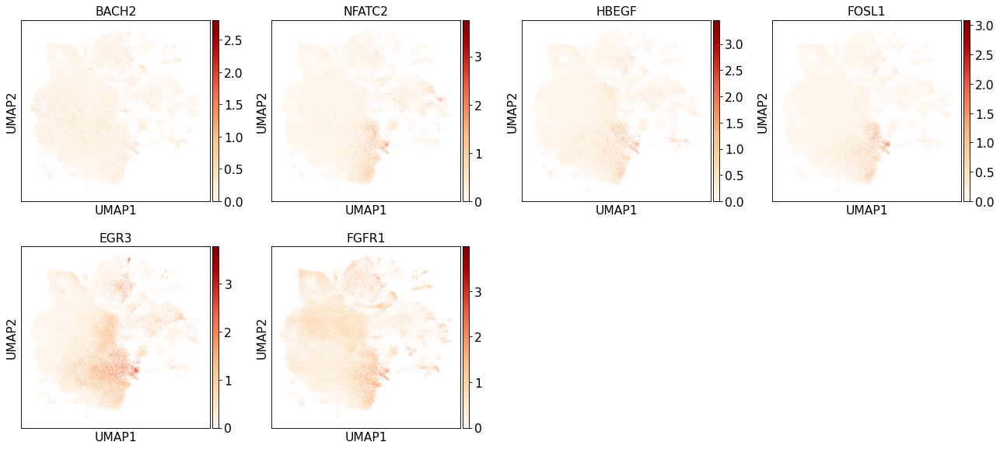

dS menstrual


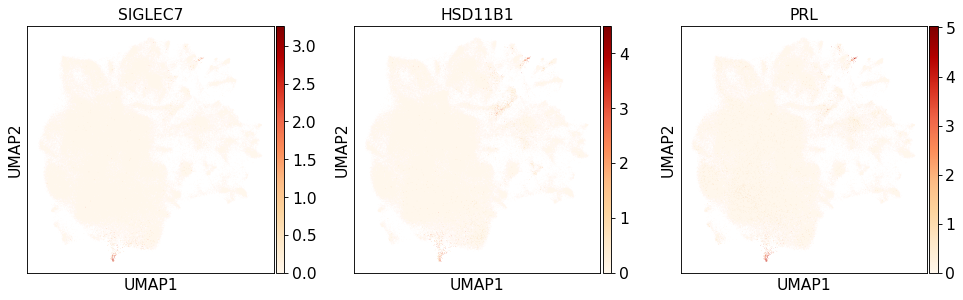

PV lineage


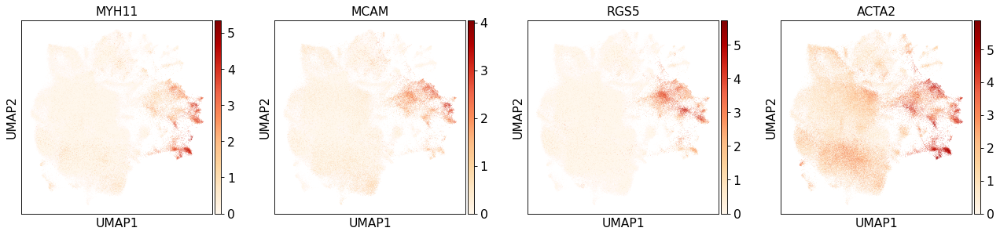

ePV STEAP4


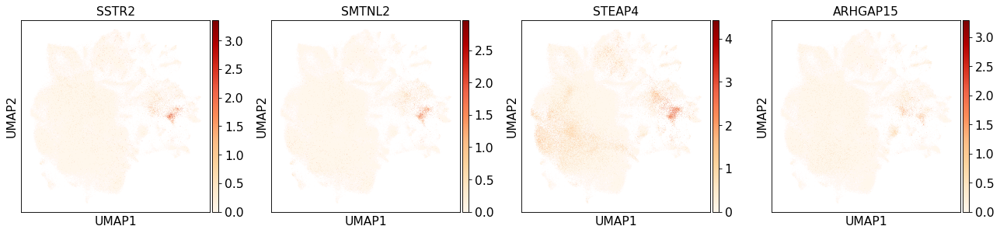

ePV MMP11


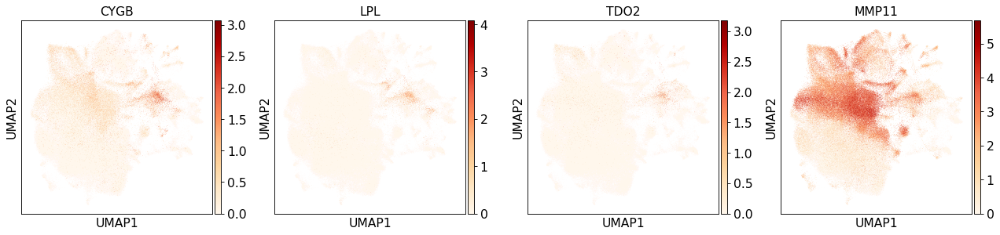

ePV AOC3


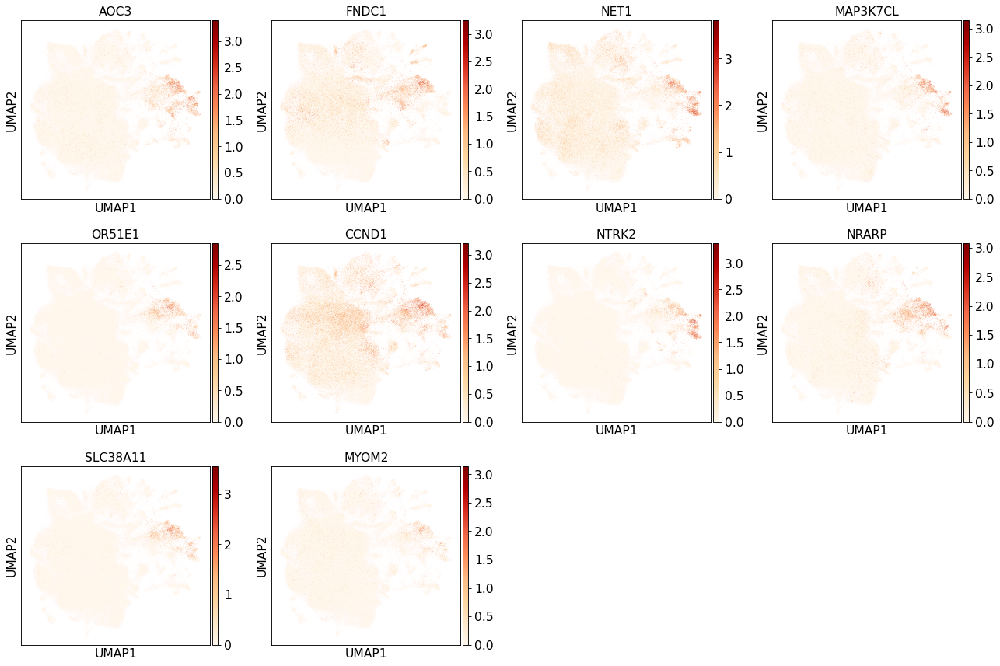

mPV MYH11


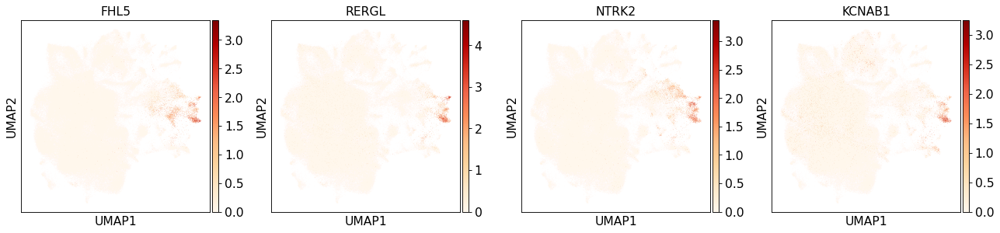

PV lessions CCL19


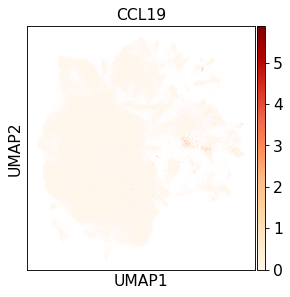

Fibroblast C7


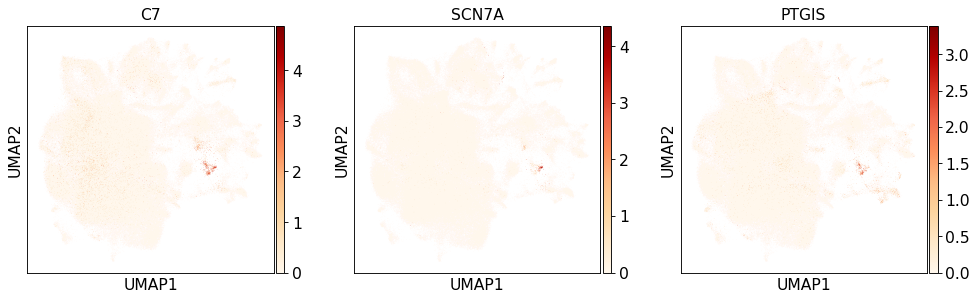

vascularSMCs


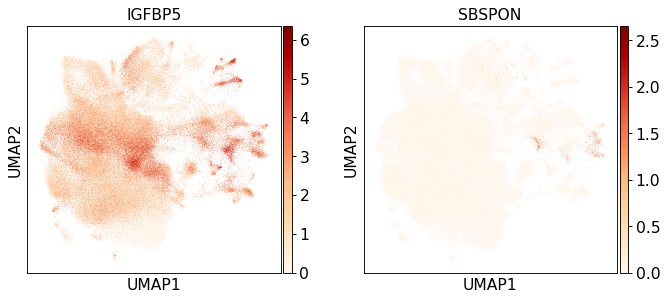

uSMCs


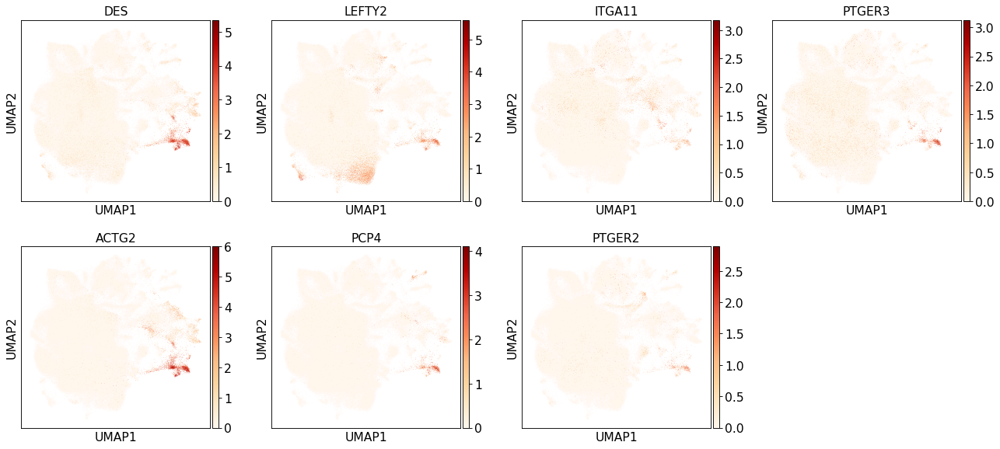

HOXA13


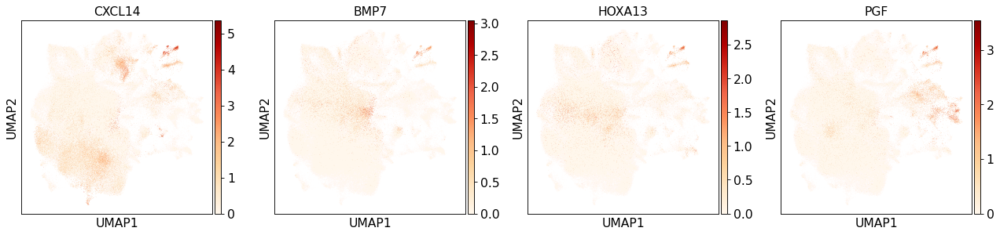

non-vascularSMCs


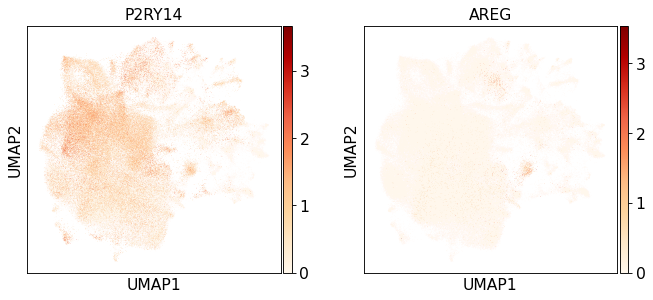

Epithelial lineage


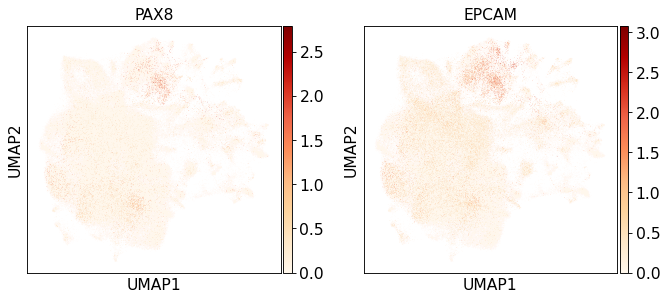

Endothelial


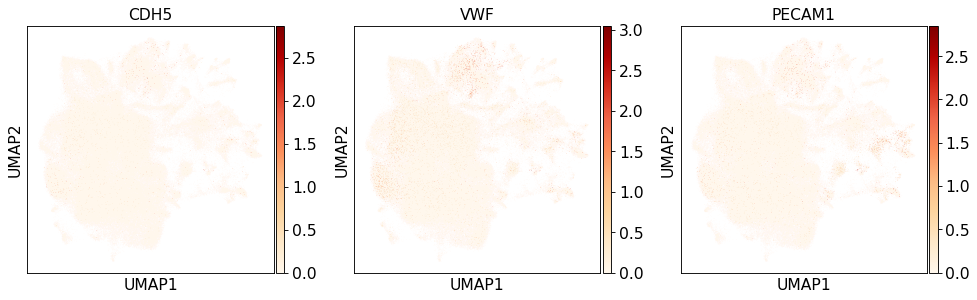

Immune


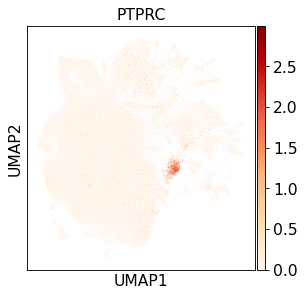

Lymphoid


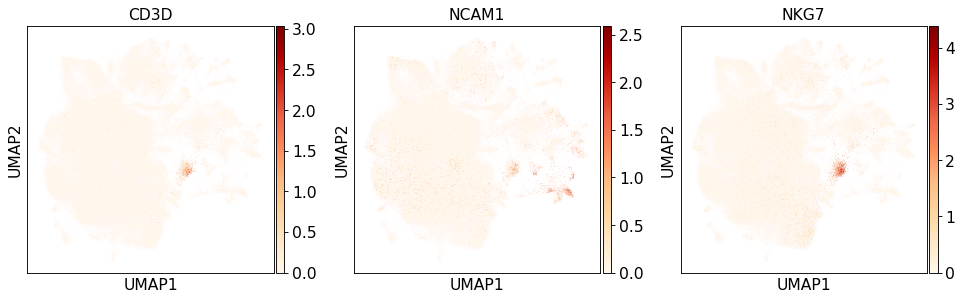

Myeloid


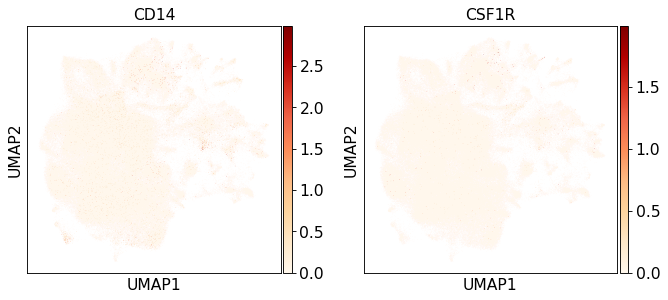

WIF1


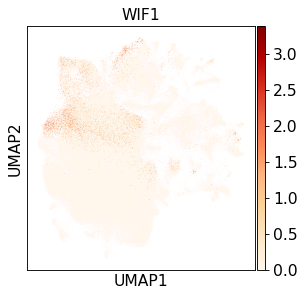

P4 withdrawal


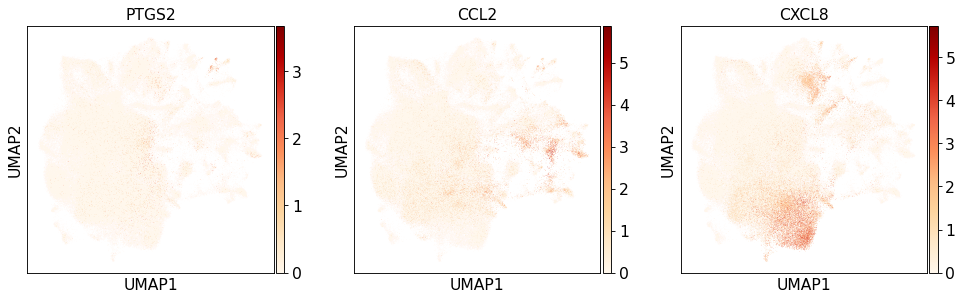

HOXA


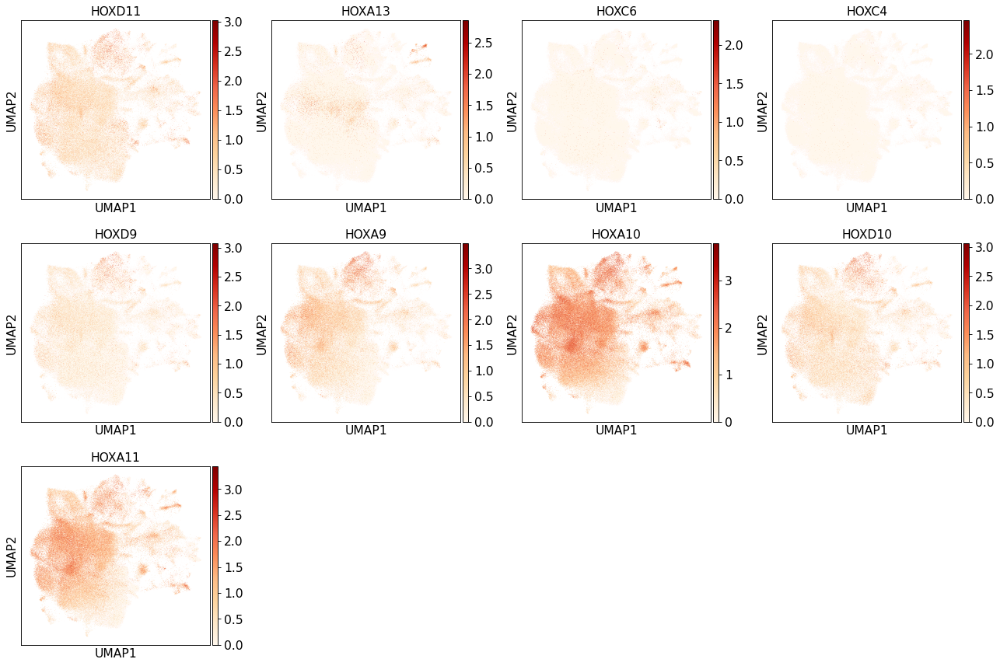

dS Inflamatory


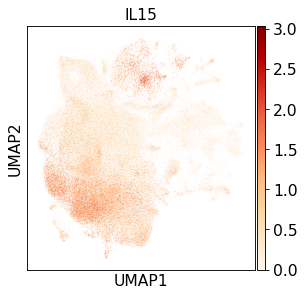

MUC5B


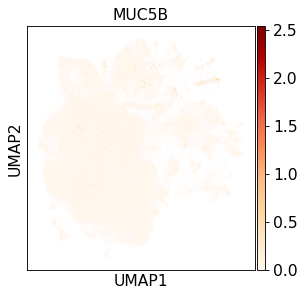

lowQC


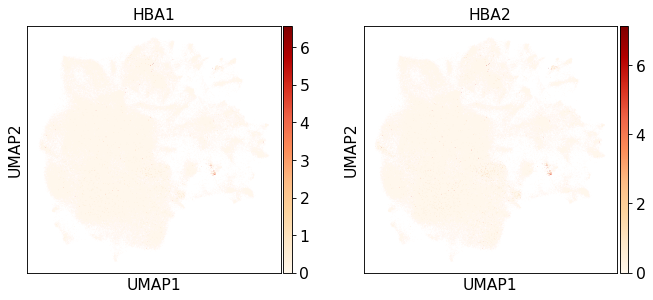

In [25]:
for i in marker_genes.keys():
    print(i)
    sc.pl.umap(adata, color=marker_genes[i], color_map='OrRd', use_raw=False )

### Check global trends

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


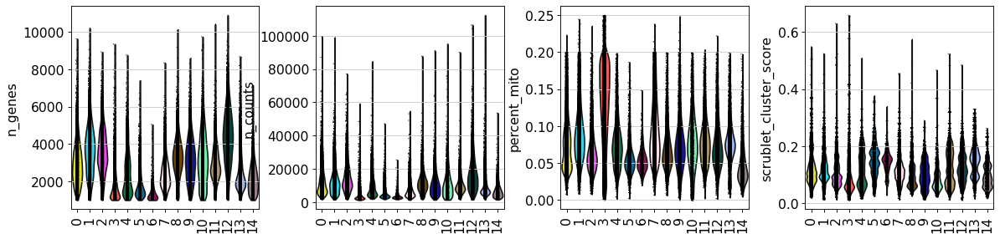

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


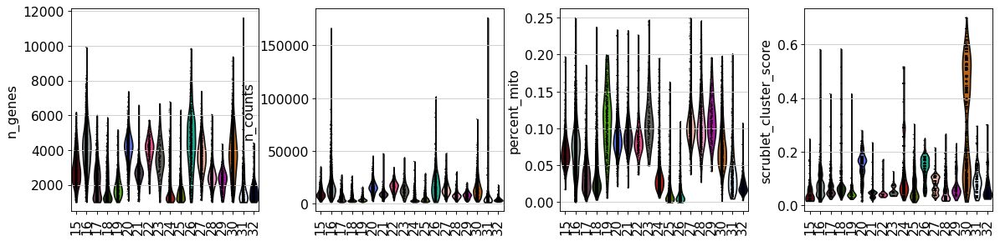

In [26]:
sc.pl.violin(adata[[ float(i) < 15 for i in adata.obs.leiden ]], keys= ['n_genes', 'n_counts', 'percent_mito', 'scrublet_cluster_score'], groupby = 'leiden_R', rotation = 90)
sc.pl.violin(adata[[ float(i) >= 15 for i in adata.obs.leiden ]], keys= ['n_genes', 'n_counts', 'percent_mito', 'scrublet_cluster_score'], groupby = 'leiden_R', rotation = 90)
# sc.pl.violin(adata, keys= ['percent_mito', 'scrublet_score', 'scrublet_cluster_score'], groupby = 'leiden_R', rotation = 90)

# Finding marker genes

Compute a ranking for the highly differential genes in each cluster. Here, we simply rank genes with a t test, which agrees quite well with Seurat.

## All vs rest

In [27]:
# # Compute Mann-Withney test with scanpy
# sc.tl.rank_genes_groups(adata, groupby='leiden', use_raw=False) #, method='logreg'
# # Plot
# sc.pl.rank_genes_groups_dotplot(adata, n_genes=20, dendrogram=False, save='_scanpy.pdf', standard_scale = 'var')

In [28]:
def Barplot(which_var, adata, var='lineage', height=3, color = False):
    plotdata = pd.crosstab(adata.obs[var], adata.obs[which_var], normalize='index') * 100
    if 'category' in plotdata.index.dtype.name:
        plotdata.index.reorder_categories(adata.obs[var].cat.categories[::-1])

    if not color:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False)
    else:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False, color = color)
    ax1.set_title(which_var+' %')
    ax1.set_ylabel(var)
    horiz_offset = 1
    vert_offset = 1.
    ax1 = ax1.legend(bbox_to_anchor = (horiz_offset, vert_offset))
    ax1.figure.savefig(str(sc.settings.figdir)+'/barplot_'+var+'_proportions_'+which_var+'.pdf', bbox_inches='tight',
                       dpi=300, orientation='landscape', format= 'pdf', optimize=True)

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error two minor releases later
  app.launch_new_instance()
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error two minor releases later
  app.launch_new_instance()
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error two minor releases later
  app.launch_new_instance()
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning

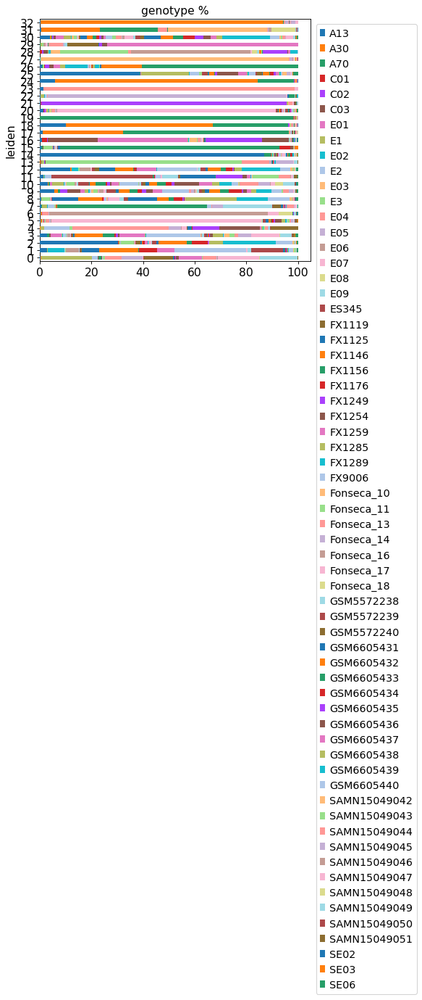

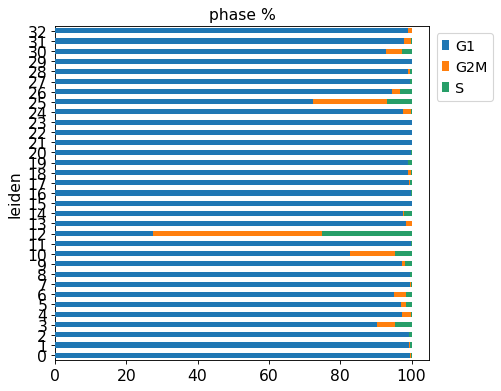

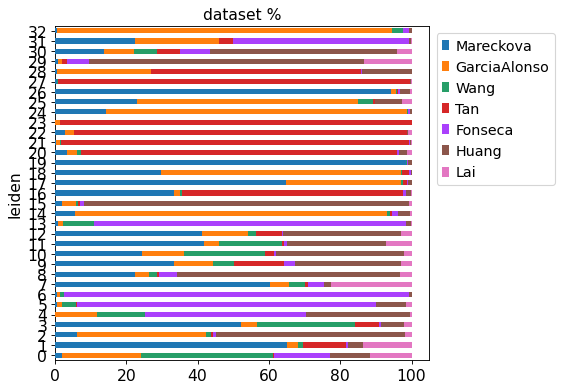

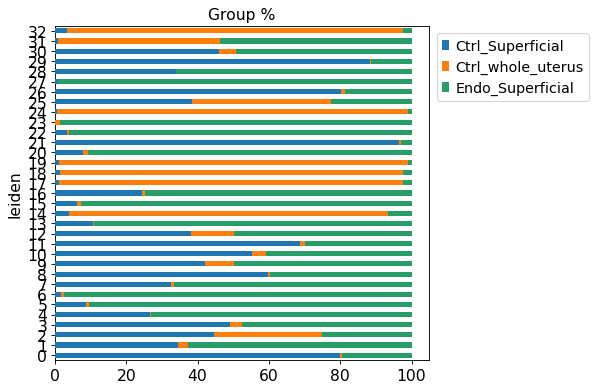

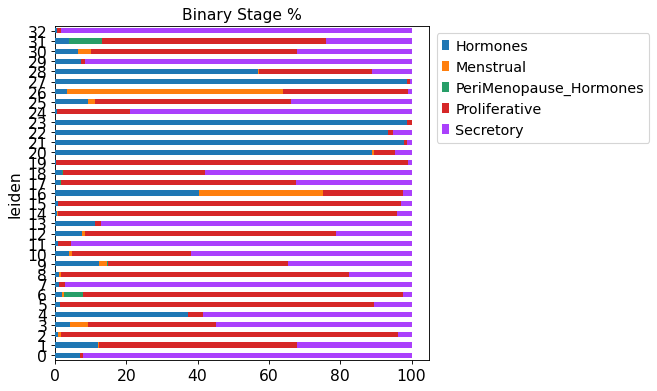

In [29]:
Barplot('genotype', adata, var='leiden', height=5.5)
Barplot('phase', adata, var='leiden', height=5.5)
Barplot('dataset', adata, var='leiden', height=5.5)
Barplot('Group', adata, var='leiden', height=5.5)
Barplot('Binary Stage', adata, var='leiden', height=5.5)

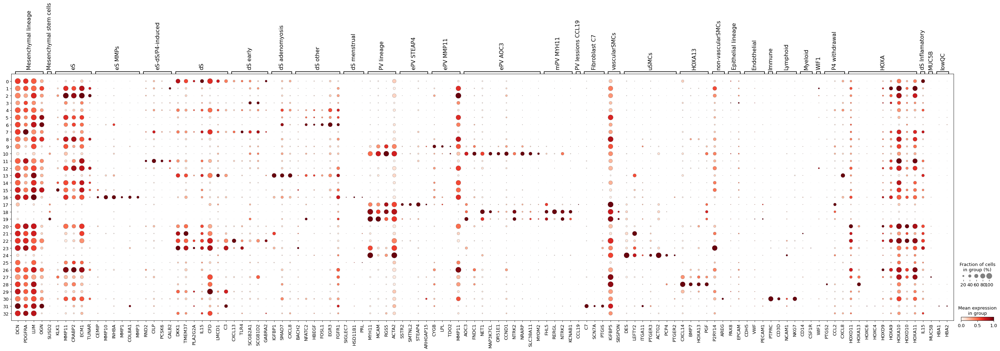

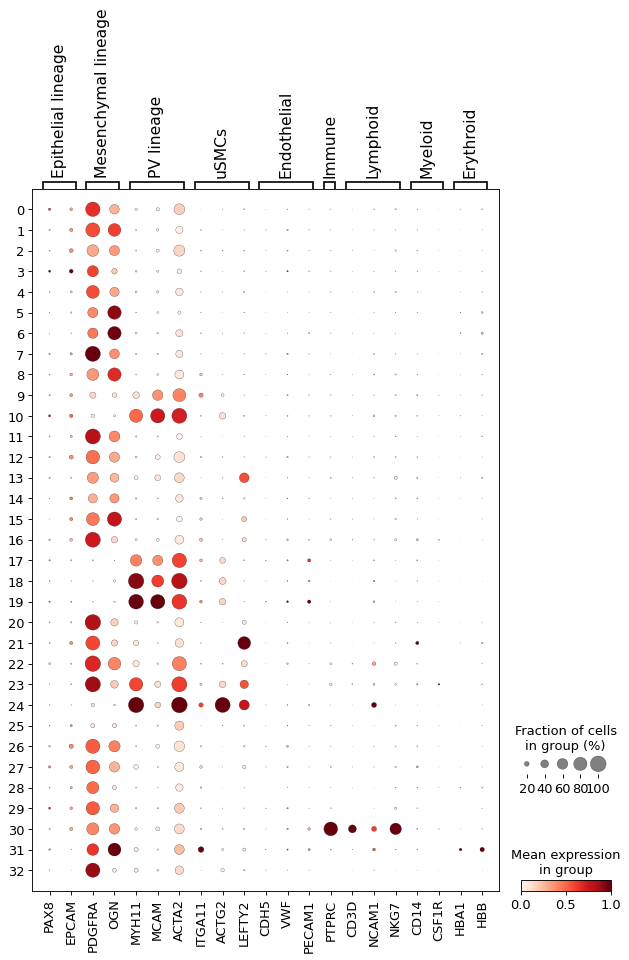

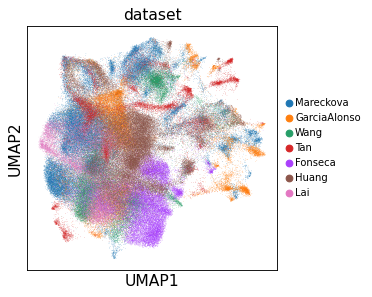

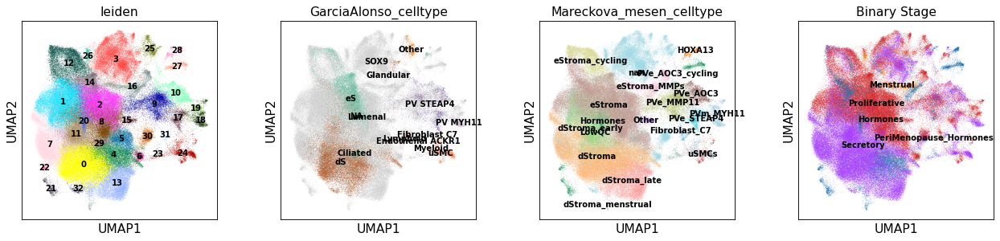

In [30]:
sc.pl.dotplot(adata, marker_genes, groupby='leiden', standard_scale='var', save='MARKERS_leiden.pdf')
sc.pl.dotplot(adata, marker_genes_short, groupby='leiden', standard_scale='var')



sc.pl.umap(adata, color=['dataset'], legend_fontsize=9)
sc.pl.umap(adata, color=['leiden', 'GarciaAlonso_celltype', 'Mareckova_mesen_celltype','Binary Stage'],legend_loc='on data', legend_fontsize=9, save='_leiden.pdf')

# Cell's Annotation

... storing 'Mareckova_mesen_celltype' as categorical
... storing 'Mareckova_mesen_lineage' as categorical


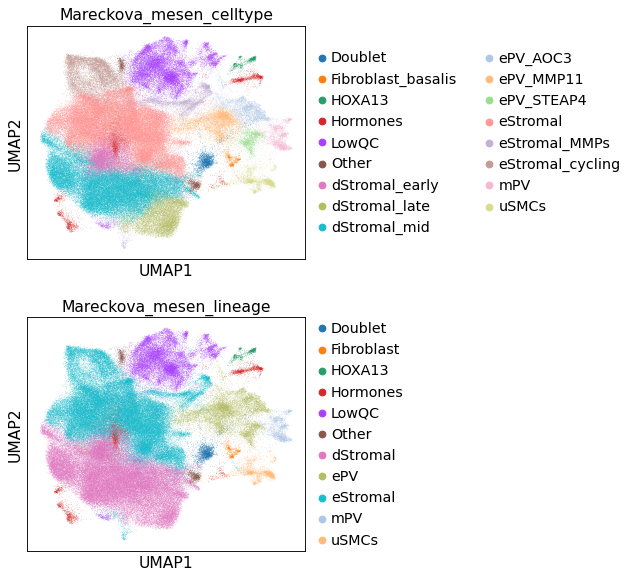

In [31]:
adata.obs['Mareckova_mesen_celltype'] = adata.obs['leiden'].tolist()
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '0', 'Mareckova_mesen_celltype'] = 'dStromal_mid'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '1', 'Mareckova_mesen_celltype'] = 'eStromal'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '2', 'Mareckova_mesen_celltype'] = 'eStromal'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '3', 'Mareckova_mesen_celltype'] = 'LowQC'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '4', 'Mareckova_mesen_celltype'] = 'dStromal_mid'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '5', 'Mareckova_mesen_celltype'] = 'eStromal'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '6', 'Mareckova_mesen_celltype'] = 'Other'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '7', 'Mareckova_mesen_celltype'] = 'dStromal_mid'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '8', 'Mareckova_mesen_celltype'] = 'eStromal'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '9', 'Mareckova_mesen_celltype'] = 'ePV_MMP11'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '10', 'Mareckova_mesen_celltype'] = 'ePV_AOC3'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '11', 'Mareckova_mesen_celltype'] = 'dStromal_early'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '12', 'Mareckova_mesen_celltype'] = 'eStromal_cycling'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '13', 'Mareckova_mesen_celltype'] = 'dStromal_late'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '14', 'Mareckova_mesen_celltype'] = 'eStromal'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '15', 'Mareckova_mesen_celltype'] = 'eStromal'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '16', 'Mareckova_mesen_celltype'] = 'eStromal_MMPs'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '17', 'Mareckova_mesen_celltype'] = 'ePV_STEAP4'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '18', 'Mareckova_mesen_celltype'] = 'mPV'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '19', 'Mareckova_mesen_celltype'] = 'mPV'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '20', 'Mareckova_mesen_celltype'] = 'Hormones'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '21', 'Mareckova_mesen_celltype'] = 'Hormones'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '22', 'Mareckova_mesen_celltype'] = 'Hormones'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '23', 'Mareckova_mesen_celltype'] = 'Hormones'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '24', 'Mareckova_mesen_celltype'] = 'uSMCs'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '25', 'Mareckova_mesen_celltype'] = 'LowQC'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '26', 'Mareckova_mesen_celltype'] = 'Other'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '27', 'Mareckova_mesen_celltype'] = 'Hormones'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '28', 'Mareckova_mesen_celltype'] = 'HOXA13'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '29', 'Mareckova_mesen_celltype'] = 'dStromal_mid'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '30', 'Mareckova_mesen_celltype'] = 'Doublet'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '31', 'Mareckova_mesen_celltype'] = 'Fibroblast_basalis'
adata.obs.at[adata.obs['Mareckova_mesen_celltype'] == '32', 'Mareckova_mesen_celltype'] = 'LowQC'


set(adata.obs['Mareckova_mesen_celltype'])
adata.obs['Mareckova_mesen_lineage'] = [str(i).split('_', 1)[0] for i in adata.obs['Mareckova_mesen_celltype'] ]

sc.pl.umap(adata, color=['Mareckova_mesen_celltype', 'Mareckova_mesen_lineage'], ncols=1)
# adata.obs['Mareckova_mesen_celltype'].cat.reorder_categories(['Epithelial', 'Epithelial_MUC5B', 'Epithelial_Glands', 'Epithelial_Ciliated', 'Epithelial_TP63+KRT5+',
#                                                         'Mesothelial', 
#                                                         'Mesenchymal_eS', 'Mesenchymal_dS', 'Mesenchymal_C7', 
#                                                         'PV_STEAP4', 'PV_MYH11', 'uSMCs',
#                                                         'Endothelial', 'Endothelial_LEC', 'Myeloid', 'Lymphoid',
#                                                         'EcO_Mesenchymal',
#                                                         'EcO_Mesenchymal_COL10A1'
#                                                         'EcO_Granulosa', 'EcO_Theca',
#                                                         'LowQC', 'Doublet'], inplace=True)

# sc.pl.umap(adata, color=['Mareckova_mesen_celltype'])

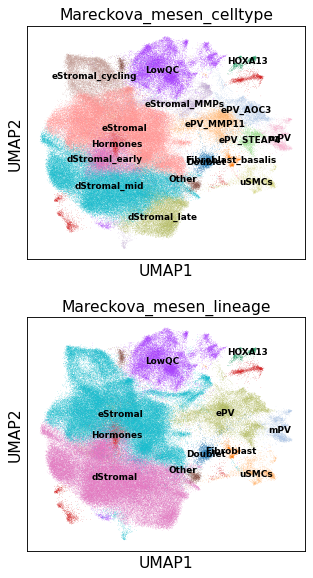

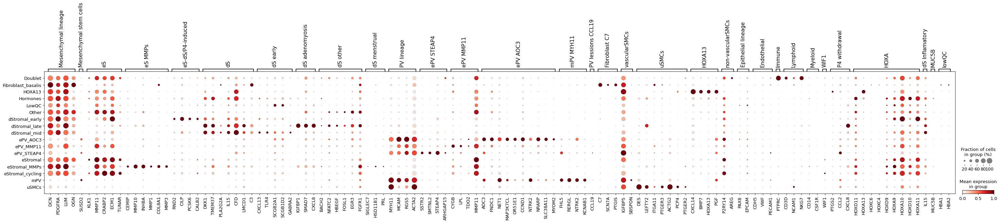

... storing 'leiden_celltype' as categorical
... storing 'celltype_leiden' as categorical


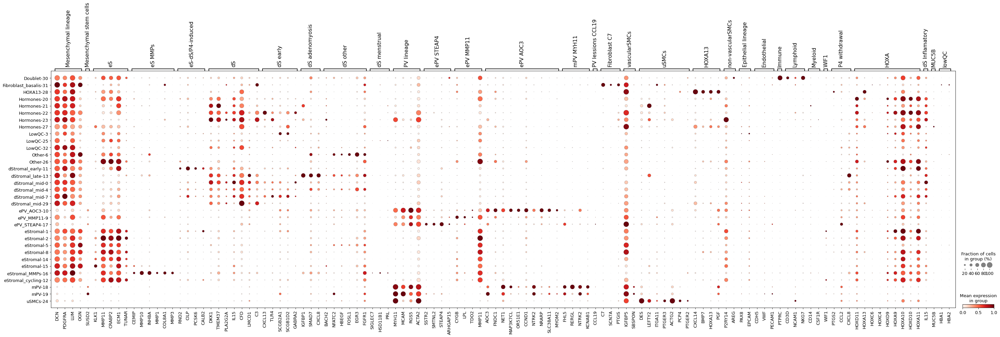

In [32]:
sc.pl.umap(adata, color=['Mareckova_mesen_celltype', 'Mareckova_mesen_lineage'], legend_loc='on data', legend_fontsize=8, ncols=1, save='_mesenchymal_celltype.pdf')
sc.pl.dotplot(adata, marker_genes, groupby='Mareckova_mesen_celltype', standard_scale='var', save='MARKERS_celltype.pdf')

adata.obs['leiden_celltype'] =  [a + '-' + b  for a, b in zip(adata.obs['leiden'], adata.obs['Mareckova_mesen_celltype'])]
adata.obs['celltype_leiden'] =  [a + '-' + b  for b, a in zip(adata.obs['leiden'], adata.obs['Mareckova_mesen_celltype'])]
sc.pl.dotplot(adata, marker_genes, groupby='celltype_leiden', standard_scale='var')

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.


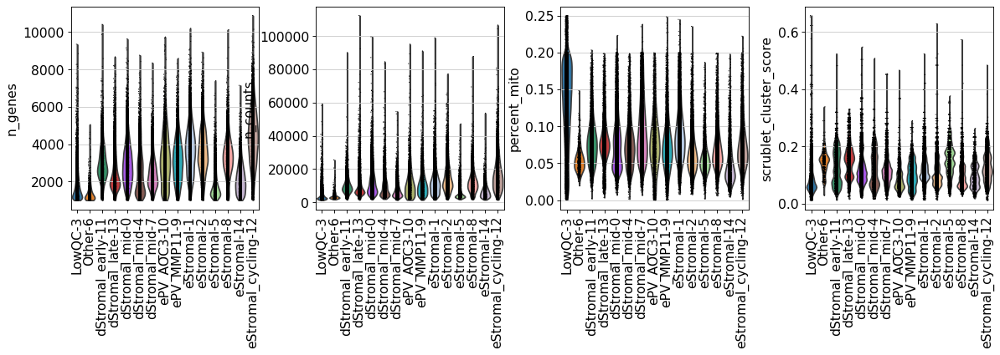

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.


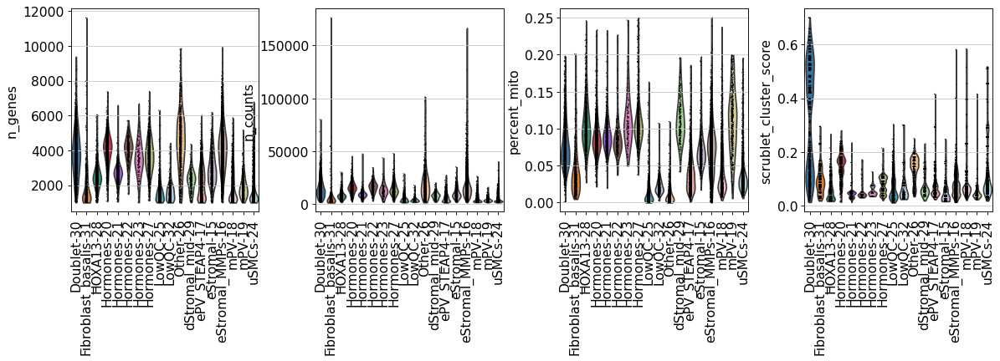

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error two minor releases later
  app.launch_new_instance()
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error two minor releases later
  app.launch_new_instance()
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error two minor releases later
  app.launch_new_instance()


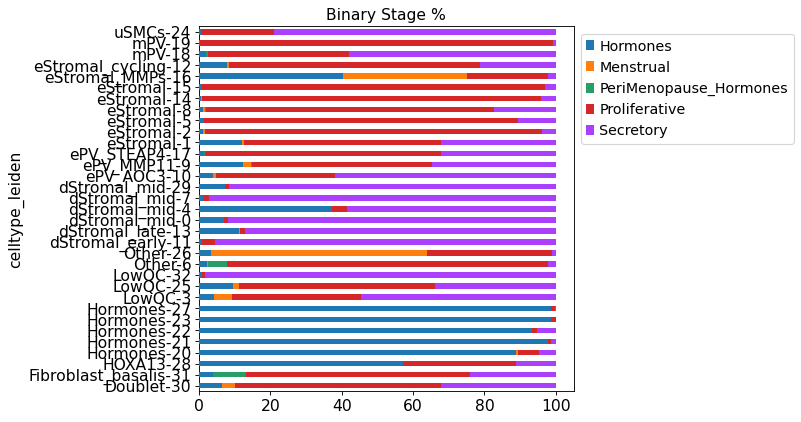

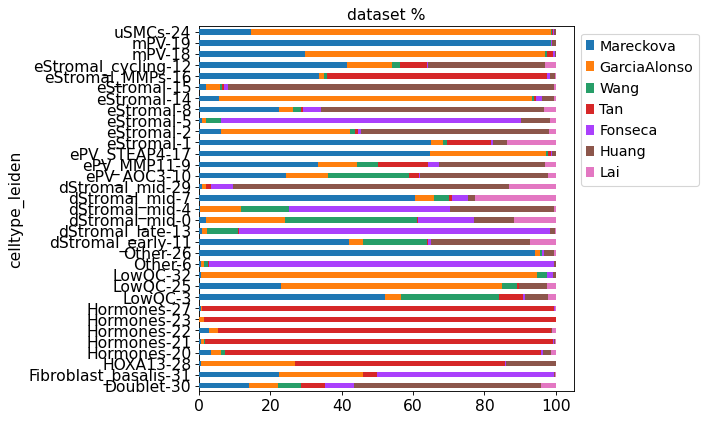

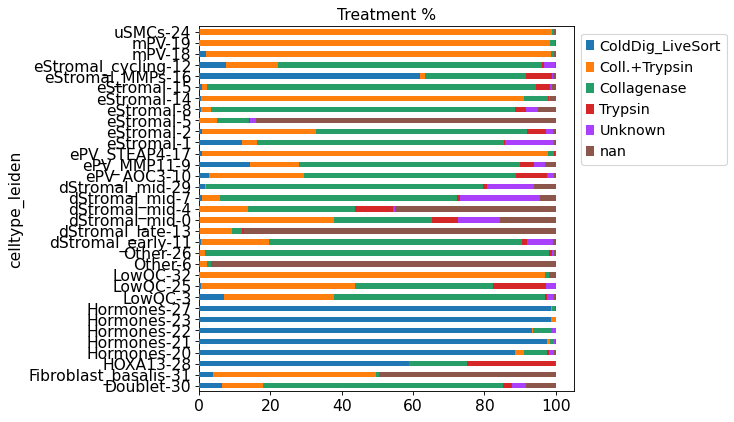

In [33]:
sc.pl.violin(adata[[ float(i) < 15 for i in adata.obs.leiden ]], keys= ['n_genes', 'n_counts', 'percent_mito', 'scrublet_cluster_score'], groupby = 'celltype_leiden', rotation = 90)
sc.pl.violin(adata[[ float(i) >= 15 for i in adata.obs.leiden ]], keys= ['n_genes', 'n_counts', 'percent_mito', 'scrublet_cluster_score'], groupby = 'celltype_leiden', rotation = 90)
# sc.pl.violin(adata, keys= ['percent_mito', 'scrublet_score', 'scrublet_cluster_score'], groupby = 'leiden_R', rotation = 90)
Barplot('Binary Stage', adata, var='celltype_leiden', height=6)
Barplot('dataset', adata, var='celltype_leiden', height=6)
Barplot('Treatment', adata, var='celltype_leiden', height=6)

In [34]:
# adata.write('x.h5ad')
pd.DataFrame(adata.obs).to_csv('/nfs/team292/lg18/endometriosis/annotations/cells_endometrium_mesenchymal.csv')

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error two minor releases later
  app.launch_new_instance()
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error two minor releases later
  app.launch_new_instance()
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error two minor releases later
  app.launch_new_instance()
/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning

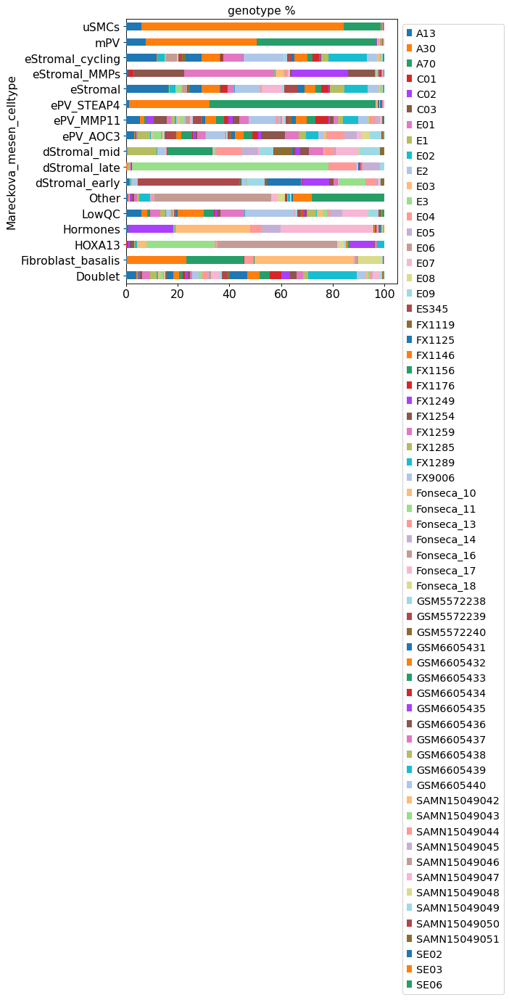

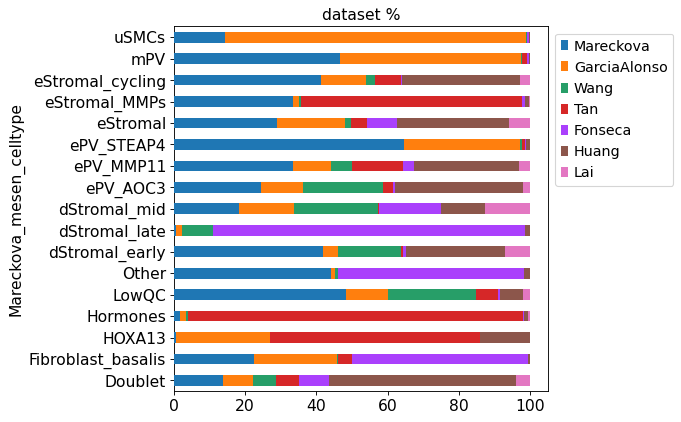

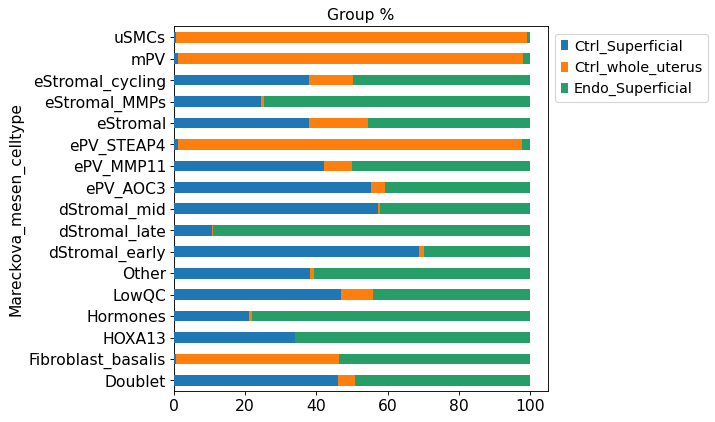

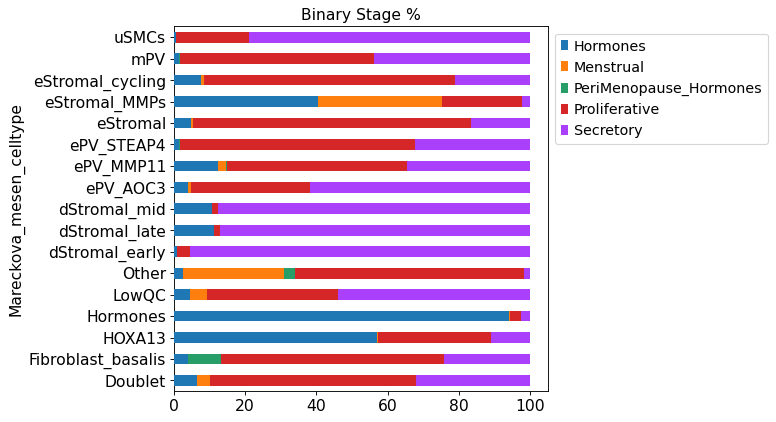

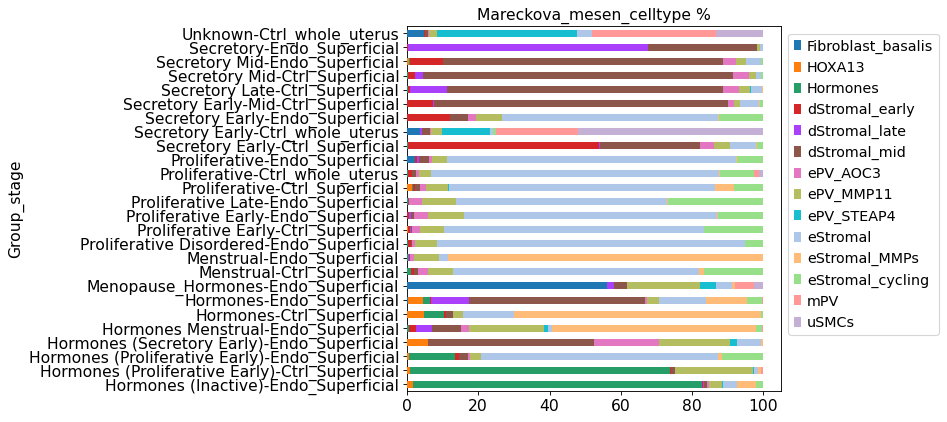

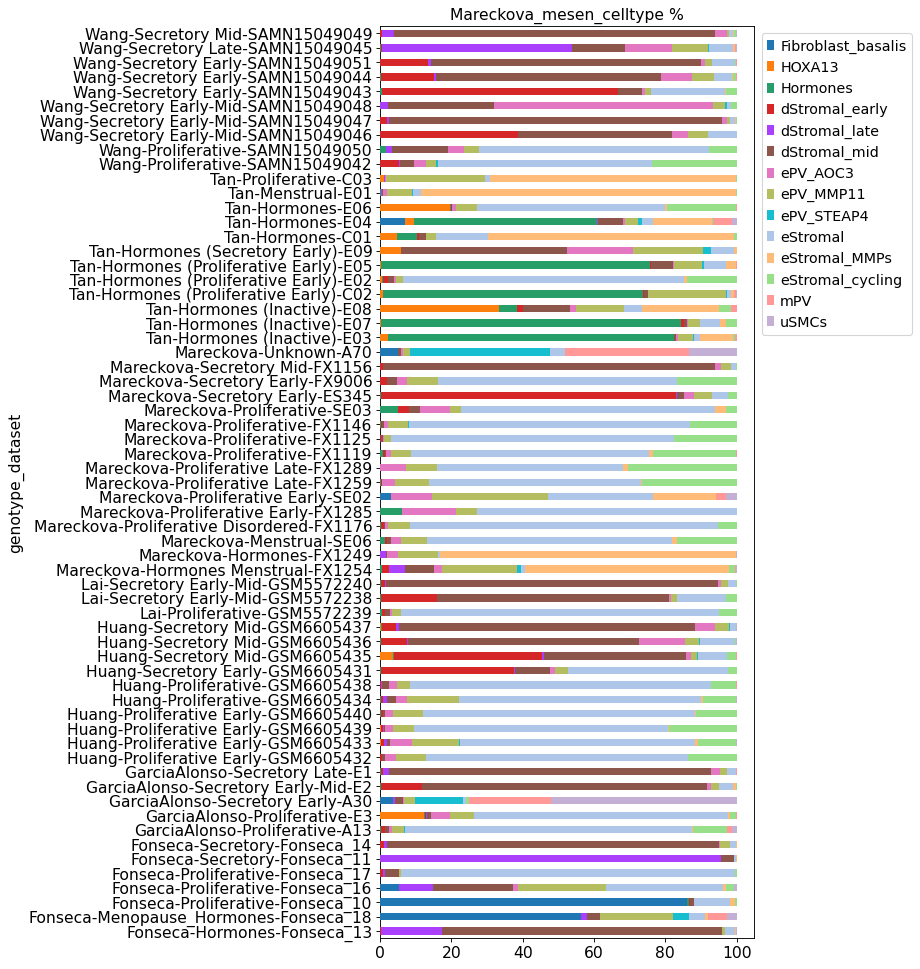

In [35]:
sampleID = [a + '-' + b + '-' + c  for a, b, c in zip(adata.obs['dataset'], adata.obs['Stage'],adata.obs['genotype'])]
adata.obs['genotype_dataset'] = sampleID

sampleID = [a + '-' + b  for a, b in zip(adata.obs['Stage'], adata.obs['Group'])]
adata.obs['Group_stage'] = sampleID

Barplot('genotype', adata, var='Mareckova_mesen_celltype', height=6)
Barplot('dataset', adata, var='Mareckova_mesen_celltype', height=6)
Barplot('Group', adata, var='Mareckova_mesen_celltype', height=6)
Barplot('Binary Stage', adata, var='Mareckova_mesen_celltype', height=6)


Barplot('Mareckova_mesen_celltype', adata[[ i not in ['Doublet', 'LowQC', 'Other'] for i in adata.obs.Mareckova_mesen_celltype ]], 
        var='Group_stage', height=6)
Barplot('Mareckova_mesen_celltype', adata[[ i not in ['Doublet', 'LowQC', 'Other'] for i in adata.obs.Mareckova_mesen_celltype ]], 
        var='genotype_dataset', height=15)

# TF-IDF

In [36]:
import anndata
adataDown = adata[[ i in ["G1"] for i in adata.obs.phase ]]
adataDown = adataDown[[ i not in ["Hormones"] for i in adataDown.obs.Mareckova_mesen_celltype ]]
sc.pp.filter_cells(adataDown, min_genes=2000)
sc.pp.filter_genes(adataDown, min_cells=5)
# print(adataDown.obs['leiden'].value_counts())

### Dowsample the whole dataset UN-EVEN
# adataDown = sc.pp.subsample(XX, fraction=0.25, random_state=0, copy=True) 


### Downsample to the smallest pop size
target_cells = 50

adataDown.obs['cell'] = adataDown.obs.index
adatas = [adataDown[adataDown.obs['leiden'].isin([cl])] for cl in adataDown.obs['leiden'].cat.categories]
# adatas = [adataDown[ adataDown.obs['leiden']==cl ] for cl in adataDown.obs['leiden'].cat.categories]

for dat in adatas:
    if dat.n_obs > target_cells:
        sc.pp.subsample(dat, n_obs=target_cells, random_state=0)
adata_downsampled = adatas[0].concatenate(*adatas[1:])
adataDown = adataDown[[ i in adata_downsampled.obs.cell.tolist() for i in adataDown.obs['cell'] ]]

sc.pp.filter_genes(adataDown, min_cells=10)
print(adataDown.obs['leiden'].value_counts())

del adata_downsampled
del adatas

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
filtered out 56495 cells that have less than 2000 genes expressed
Trying to set attribute `.obs` of view, copying.
filtered out 6 genes that are detected in less than 5 cells
filtered out 3406 genes that are detected in less than 10 cells
Trying to set attribute `.var` of view, copying.


0     50
1     50
31    50
30    50
29    50
28    50
26    50
25    50
24    50
19    50
18    50
17    50
16    50
15    50
14    50
13    50
12    50
11    50
10    50
9     50
8     50
7     50
6     50
5     50
4     50
3     50
2     50
32    50
Name: leiden, dtype: int64


In [37]:
import rpy2.rinterface_lib.callbacks
import logging
# Itoliste R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)
import anndata2ri
anndata2ri.activate()
%load_ext rpy2.ipython


In [38]:
# This is just to allow moving adata to R without errors
adataDown.X = adataDown.X.toarray()

idx = ['n_genes', 'sample',  'percent_mito', 'n_counts', 'batch', 'S_score', 'G2M_score', 'phase', 
       'scrublet_score', 'scrublet_cluster_score', 'zscore', 'bh_pval', 'bonf_pval', 'is_doublet']
for i in idx:
    del adataDown.obs[i]
    
adataDown.obs['leiden'] = adataDown.obs['leiden'].astype(str)

del adataDown.obsm['X_scVI']
del adataDown.obsm['X_umap']
del adataDown.obsp['connectivities']
del adataDown.obsp['distances']
del adataDown.uns

In [39]:
%%R -i adataDown
adataDown

class: SingleCellExperiment 
dim: 14324 1400 
metadata(0):
assays(1): X
rownames(14324): A1BG A2M ... ZYX ZZEF1
rowData names(220): gene_ids.0.Fonseca feature_types.0.Fonseca ...
  highly_variable_nbatches n_cells
colnames(1400): HCA_A_RepT_RNA13247830_AAACGGGGTTGTGGCC-Mareckova
  HCA_A_RepT_RNA13247830_AACGTTGCAGCTGCTG-Mareckova ...
  GSM5572240_TTGAGTGGTGTCCCTT-Lai GSM5572240_TTGTGTTGTGCCTAAT-Lai
colData names(63): library StudyName ... Group_stage cell
reducedDimNames(0):
altExpNames(0):


### By Leiden

In [40]:
%%R -o df_tfIDF -o topgenes_tfIDF

library(Seurat)
library(SoupX)
library(dplyr)
seurat_andata = as.Seurat(adataDown, counts = "X", data = "X")
Idents(seurat_andata) = seurat_andata$celltype_leiden


df_tfIDF = quickMarkers(toc = seurat_andata@assays$RNA@counts, clusters = Idents(seurat_andata), N = 500)

df_tfIDF$cluster = factor(df_tfIDF$cluster, levels = unique(sort(df_tfIDF$cluster ))  )
topgenes_tfIDF = subset(df_tfIDF, qval <= 0.05) %>%
  group_by(cluster) %>%
  group_map(~ head(.x, 20L)$gene)
names(topgenes_tfIDF) = paste('cl', levels(df_tfIDF$cluster) )

In [41]:
df_tfIDF.to_csv('TFIDF_leiden.tsv', index=False, sep='\t')

... storing 'genotype_dataset' as categorical
... storing 'Group_stage' as categorical


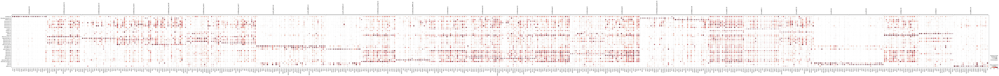

In [42]:
topgenes_tfIDF = dict(zip(topgenes_tfIDF.names, map(list,list(topgenes_tfIDF)))) # this is to convert into a dictionary for plotting
for i in topgenes_tfIDF.keys():
    topgenes_tfIDF[i] = [value for value in topgenes_tfIDF[i] if value in adata.var_names] 
    
sc.pl.dotplot(adata, topgenes_tfIDF, groupby='celltype_leiden', standard_scale = 'var', save='TFIDF_leiden.pdf')#topgenes_tfIDF

## By celltype

In [43]:
import anndata
adataDown = adata[[ i in ["G1"] for i in adata.obs.phase ]]
sc.pp.filter_cells(adataDown, min_genes=2000)
sc.pp.filter_genes(adataDown, min_cells=3)
adataDown = adataDown[[ i not in ['Doublet', 'LowQC', 'eS_cycling'] for i in adataDown.obs.Mareckova_mesen_celltype ]]
# print(adataDown.obs['leiden'].value_counts())

### Dowsample the whole dataset UN-EVEN
# adataDown = sc.pp.subsample(XX, fraction=0.25, random_state=0, copy=True) 


### Downsample to the smallest pop size
target_cells = 100

adataDown.obs['cell'] = adataDown.obs.index
adatas = [adataDown[adataDown.obs['Mareckova_mesen_celltype'].isin([cl])] for cl in adataDown.obs['Mareckova_mesen_celltype'].cat.categories]
# adatas = [adataDown[ adataDown.obs['leiden']==cl ] for cl in adataDown.obs['leiden'].cat.categories]

for dat in adatas:
    if dat.n_obs > target_cells:
        sc.pp.subsample(dat, n_obs=target_cells, random_state=0)
adata_downsampled = adatas[0].concatenate(*adatas[1:])
adataDown = adataDown[[ i in adata_downsampled.obs.cell.tolist() for i in adataDown.obs['cell'] ]]

sc.pp.filter_genes(adataDown, min_cells=10)
print(adataDown.obs['Mareckova_mesen_celltype'].value_counts())

del adata_downsampled
del adatas

/home/jovyan/my-conda-envs/sc_analysis/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
filtered out 56674 cells that have less than 2000 genes expressed
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
filtered out 3205 genes that are detected in less than 10 cells
Trying to set attribute `.var` of view, copying.


Fibroblast_basalis    100
HOXA13                100
Hormones              100
Other                 100
dStromal_early        100
dStromal_late         100
dStromal_mid          100
ePV_AOC3              100
ePV_MMP11             100
ePV_STEAP4            100
eStromal              100
eStromal_MMPs         100
eStromal_cycling      100
mPV                   100
uSMCs                 100
Name: Mareckova_mesen_celltype, dtype: int64


In [44]:
import rpy2.rinterface_lib.callbacks
import logging
# Itoliste R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)
import anndata2ri
anndata2ri.activate()
%load_ext rpy2.ipython


The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython


In [45]:
# This is just to allow moving adata to R without errors
adataDown.X = adataDown.X.toarray()

idx = ['n_genes', 'sample',  'percent_mito', 'n_counts', 'batch', 'S_score', 'G2M_score', 'phase', 
       'scrublet_score', 'scrublet_cluster_score', 'zscore', 'bh_pval', 'bonf_pval', 'is_doublet']
for i in idx:
    del adataDown.obs[i]
    
adataDown.obs['leiden'] = adataDown.obs['leiden'].astype(str)

del adataDown.obsm['X_scVI']
del adataDown.obsm['X_umap']
del adataDown.obsp['connectivities']
del adataDown.obsp['distances']
del adataDown.uns

In [46]:
%%R -i adataDown
adataDown

class: SingleCellExperiment 
dim: 14531 1500 
metadata(0):
assays(1): X
rownames(14531): A1BG A2M ... ZYX ZZEF1
rowData names(220): gene_ids.0.Fonseca feature_types.0.Fonseca ...
  highly_variable_nbatches n_cells
colnames(1500): HCA_A_RepT_RNA13247830_AAACCTGTCAGCCTAA-Mareckova
  HCA_A_RepT_RNA13247830_AAACGGGTCACTCCTG-Mareckova ...
  GSM5572240_TTACGCCTCGCAGTTA-Lai GSM5572240_TTGTGTTGTGCCTAAT-Lai
colData names(63): library StudyName ... Group_stage cell
reducedDimNames(0):
altExpNames(0):


In [47]:
%%R -o df_tfIDF -o topgenes_tfIDF

library(Seurat)
library(SoupX)
library(dplyr)
seurat_andata = as.Seurat(adataDown, counts = "X", data = "X")
Idents(seurat_andata) = seurat_andata$Mareckova_mesen_celltype


df_tfIDF = quickMarkers(toc = seurat_andata@assays$RNA@counts, clusters = Idents(seurat_andata), N = 500)

df_tfIDF$cluster = factor(df_tfIDF$cluster, levels = unique(df_tfIDF$cluster)  )
topgenes_tfIDF = subset(df_tfIDF, qval <= 1) %>%
  group_by(cluster) %>%
  group_map(~ head(.x, 30L)$gene)
names(topgenes_tfIDF) = unique(df_tfIDF$cluster)

In [48]:
df_tfIDF.to_csv('TFIDF_celltype.tsv', index=False, sep='\t')

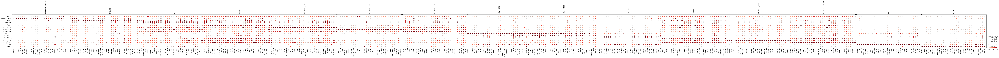

In [49]:
topgenes_tfIDF = dict(zip(topgenes_tfIDF.names, map(list,list(topgenes_tfIDF)))) # this is to convert into a dictionary for plotting
for i in topgenes_tfIDF.keys():
    topgenes_tfIDF[i] = [value for value in topgenes_tfIDF[i] if value in adata.var_names] 
    
sc.pl.dotplot(adata, topgenes_tfIDF, groupby='Mareckova_mesen_celltype', standard_scale = 'var', save='TFIDF_celltype.pdf')#topgenes_tfIDF

In [50]:
adata.write('/nfs/team292/lg18/endometriosis/clustered_objects/cells_mesenchymal.h5ad')

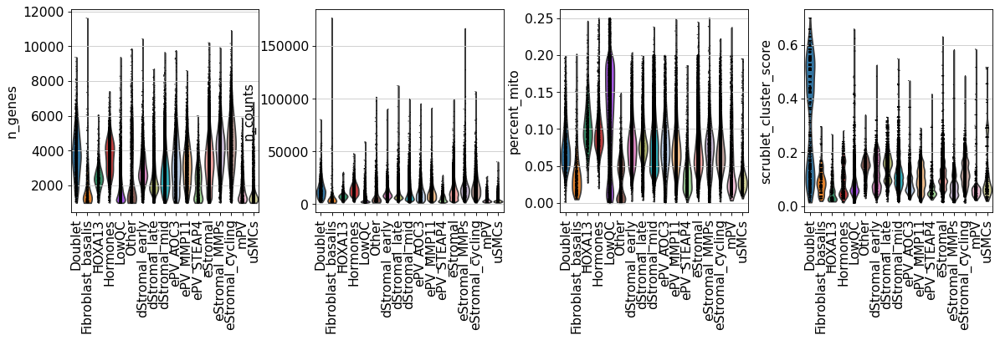

In [51]:
sc.pl.violin(adata, keys= ['n_genes', 'n_counts', 'percent_mito', 'scrublet_cluster_score'], groupby = 'Mareckova_mesen_celltype', rotation = 90)
